In [1]:
## US = 1, Germany = 2, China = 3, Russia = 4

import math
import numpy as np
from matplotlib.pyplot import subplots, cm
import sklearn.model_selection as skm
from sklearn.svm import SVC
from sklearn.metrics import RocCurveDisplay
from sklearn.model_selection import train_test_split
from sklearn.multiclass import OneVsOneClassifier
from sklearn.inspection import DecisionBoundaryDisplay

from itertools import combinations
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import auc, roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import RocCurveDisplay

from sklearn.linear_model import LogisticRegression


import sklearn.metrics as metrics


from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.callbacks import EarlyStopping


import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import matplotlib.axes as ax
from matplotlib.pyplot import figure

In [2]:
path_to_data = 'https://raw.githubusercontent.com/AndreiAf02/STAT541Project/main/'
data = pd.read_csv(path_to_data + "Project_Data.csv", sep=",", header=0)
data


,Date,National Debt,Gold Reserves,Country,CountryName
0,31-Dec-00,33.2700,8136.95,1,US
1,31-Mar-01,38.2275,8137.13,1,US
2,30-Jun-01,43.1850,8135.32,1,US
3,30-Sep-01,48.1425,8149.05,1,US
4,31-Dec-01,53.1000,8149.05,1,US
...,...,...,...,...,...
367,31-Dec-22,18.9000,2332.74,4,RU
368,31-Mar-23,19.4750,2326.52,4,RU
369,30-Jun-23,20.0500,2329.63,4,RU
370,30-Sep-23,20.6250,2332.74,4,RU


**Data Preprocessing:**

In [3]:
Data_US = pd.DataFrame()
Data_DE = pd.DataFrame()
Data_CN = pd.DataFrame()
Data_RU = pd.DataFrame()

Data_US = data[data['Country']==1]
Data_DE = data[data['Country']==2]
Data_CN = data[data['Country']==3]
Data_RU = data[data['Country']==4]

Data_US= pd.DataFrame.reset_index(Data_US)
Data_DE= pd.DataFrame.reset_index(Data_DE)
Data_CN= pd.DataFrame.reset_index(Data_CN)
Data_RU= pd.DataFrame.reset_index(Data_RU)

In [4]:
Data_US['Ratio']=Data_US['Gold Reserves']/Data_US['National Debt']

Data_DE['Ratio']=Data_DE['Gold Reserves']/Data_DE['National Debt']

Data_CN['Ratio']=Data_CN['Gold Reserves']/Data_CN['National Debt']

Data_RU['Ratio']=Data_RU['Gold Reserves']/Data_RU['National Debt']


In [5]:
Data_ratio = pd.DataFrame()

Data_ratio['index'] = Data_US['index']
Data_ratio['US'] = Data_US['Ratio']
Data_ratio['DE'] = Data_DE['Ratio']
Data_ratio['CN'] = Data_CN['Ratio']
Data_ratio['RU'] = Data_RU['Ratio']

Data_ratio

,index,US,DE,CN,RU
0,0,244.573189,58.492411,17.174348,6.876565
1,1,212.860637,58.764930,16.880769,7.365017
2,2,188.383003,59.040000,16.597059,7.858624
3,3,169.269357,59.111757,16.322727,8.581914
4,4,153.466102,59.391065,20.356098,9.526351
...,...,...,...,...,...
88,88,67.052432,50.758548,26.110519,123.425397
89,89,66.777176,50.793187,26.348535,119.461874
90,90,66.504170,50.797727,26.418250,116.191022
91,91,66.233388,50.836240,26.889939,113.102545


In [6]:
figure(figsize=(8, 6), dpi=1200)
plt.plot(Data_US['Ratio'], 'b.', label='US')
plt.plot(Data_DE['Ratio'], 'm.', label='DE')
plt.plot(Data_CN['Ratio'], 'r.', label='CN')
plt.plot(Data_RU['Ratio'], 'k.', label='RU')
plt.ylabel('Reserve to Debt Ratio')
plt.xlabel('Time')
plt.legend()

# plt.savefig("ScatterplotTime.jpg", format='jpg', dpi=1200, bbox_inches='tight')

In [7]:
X = Data_ratio['index']
y_US = Data_ratio['US']
y_DE = Data_ratio['DE']
y_CN = Data_ratio['CN']
y_RU = Data_ratio['RU']

In [8]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y_US, test_size=0.5, shuffle=True, random_state=0)


## Neural Network Regression:

In [9]:
## Adapted from https://medium.com/luca-chuangs-bapm-notes/build-a-neural-network-in-python-regression-a80a906f634c

def NeurNet(x,y,epoch):
  X_train, X_test, y_train, y_test = train_test_split(
    x, y, test_size=0.5, shuffle=True, random_state=0)

  model = Sequential()
  model.add(Dense(100, input_shape=(1,), activation='relu'))  ## Relu method in Neural Network
  model.add(Dense(50, activation='relu'))
  model.add(Dense(25, activation='relu'))
  model.add(Dense(1, activation='linear'))
  model.summary()

  model.compile(optimizer='rmsprop', loss='mse', metrics=['mae'])

  es = EarlyStopping(monitor='val_loss',
      mode='min',
      patience=50,
      restore_best_weights = True)

  ratiofit = model.fit(X_train, y_train,
                      validation_data = (X_test, y_test),
                      callbacks=[es],
                      epochs=epoch,
                      batch_size=50,
                      verbose=1)
  ratiofit_dictionary = ratiofit.history
  loss = ratiofit_dictionary['loss']
  val_loss = ratiofit_dictionary['val_loss']
  epochs = range(1, len(loss) + 1)
  figure(figsize=(8, 6), dpi=1200)
  plt.plot(epochs, loss, 'bo', label='Training loss')
  plt.plot(epochs, val_loss, 'orange', label='Testing loss')
  plt.title('Training and Testing loss')
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.legend()
  plt.show()

  fig, axes = plt.subplots(1,2, dpi=1200)

  axes[0].scatter(x=y_train, y=model.predict(X_train))
  axes[0].set_xlabel("Actual", fontsize=10)
  axes[0].set_ylabel("Predicted",  fontsize=10)
  axes[0].set_title("Training")

  x = np.linspace(*axes[0].get_xlim())
  axes[0].plot(x, x, 'k--')

  axes[1].scatter(x=y_test, y=model.predict(X_test))
  axes[1].set_xlabel("Actual", fontsize=10)
  axes[1].set_ylabel("Predicted",  fontsize=10)
  axes[1].set_title("Testing")

  x = np.linspace(*axes[1].get_xlim())
  axes[1].plot(x, x, 'k--')

  fig.tight_layout()

  plt.show()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 100)               200       
                                                                 
 dense_1 (Dense)             (None, 50)                5050      
                                                                 
 dense_2 (Dense)             (None, 25)                1275      
                                                                 
 dense_3 (Dense)             (None, 1)                 26        
                                                                 
Total params: 6551 (25.59 KB)
Trainable params: 6551 (25.59 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/1000
1/1 [==============================] - 4s 4s/step - loss: 11670.2197 - mae: 101.7475 - val_loss: 10430.7500 - val_mae: 96.1155
Epoch 2/1000
1

2/2 [==============================] - 0s 4ms/step


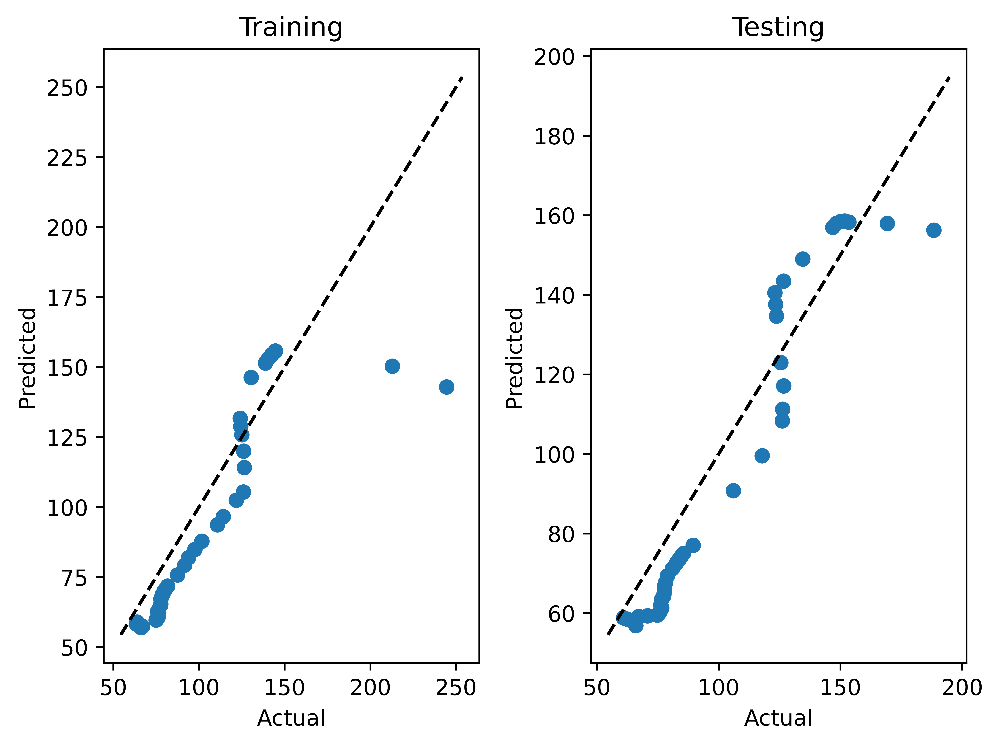

In [10]:
NeurNet(X,y_US, 1000)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             (None, 100)               200       
                                                                 
 dense_5 (Dense)             (None, 50)                5050      
                                                                 
 dense_6 (Dense)             (None, 25)                1275      
                                                                 
 dense_7 (Dense)             (None, 1)                 26        
                                                                 
Total params: 6551 (25.59 KB)
Trainable params: 6551 (25.59 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/1200
1/1 [==============================] - 1s 766ms/step - loss: 2001.5800 - mae: 44.3168 - val_loss: 1834.2283 - val_mae: 41.9595
Epoch 2/1200

2/2 [==============================] - 0s 6ms/step


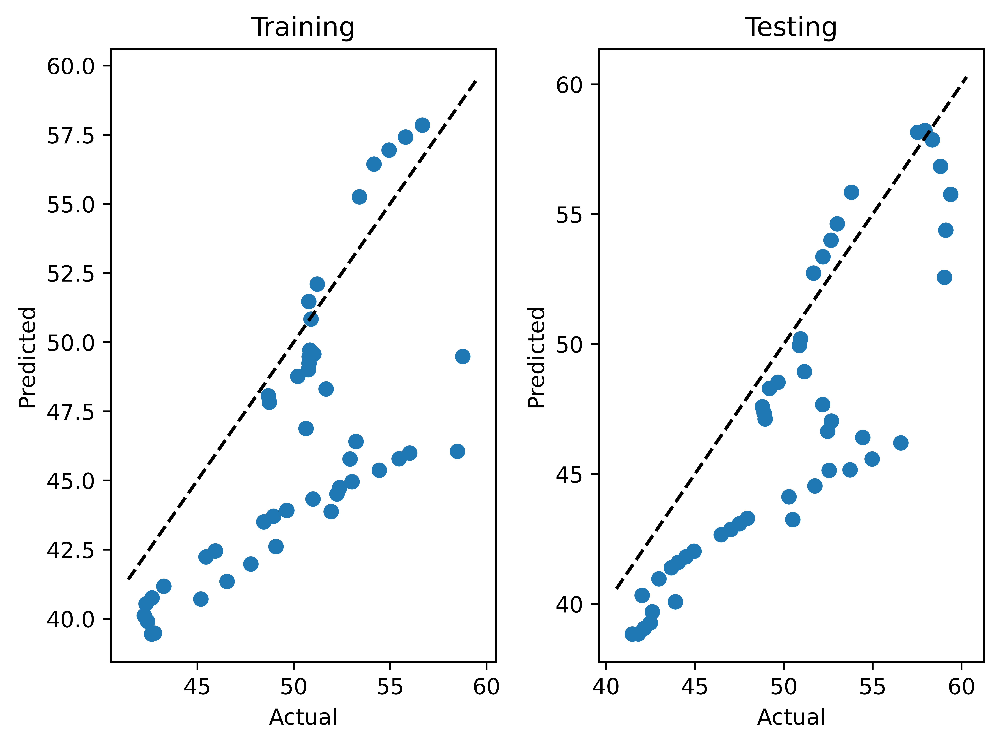

In [11]:
NeurNet(X,y_DE, 1200)

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_20 (Dense)            (None, 100)               200       
                                                                 
 dense_21 (Dense)            (None, 50)                5050      
                                                                 
 dense_22 (Dense)            (None, 25)                1275      
                                                                 
 dense_23 (Dense)            (None, 1)                 26        
                                                                 
Total params: 6551 (25.59 KB)
Trainable params: 6551 (25.59 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/800
1/1 [==============================] - 1s 812ms/step - loss: 856.8726 - mae: 28.6967 - val_loss: 717.0352 - val_mae: 26.1499
Epoch 2/800
1/1

2/2 [==============================] - 0s 6ms/step


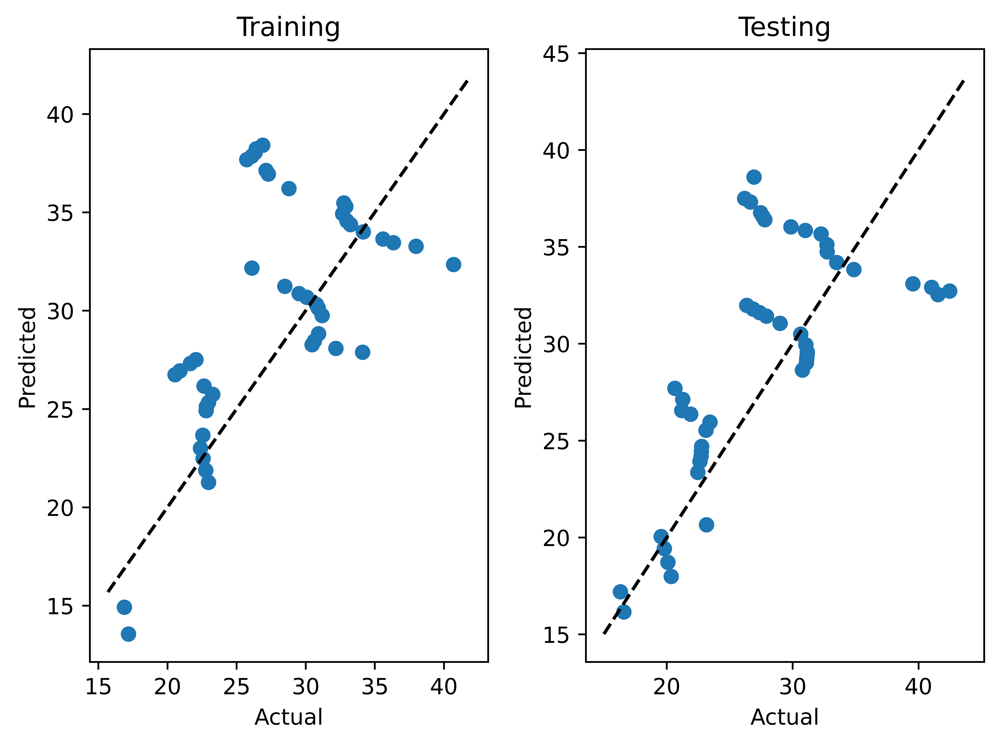

In [26]:
NeurNet(X,y_CN, 800)

Note that the Russia data below has a very low number of epochs, because the neural network stops early to avoid overfitting. The fit is the best of all four countries.

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 100)               200       
                                                                 
 dense_13 (Dense)            (None, 50)                5050      
                                                                 
 dense_14 (Dense)            (None, 25)                1275      
                                                                 
 dense_15 (Dense)            (None, 1)                 26        
                                                                 
Total params: 6551 (25.59 KB)
Trainable params: 6551 (25.59 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/200
1/1 [==============================] - 1s 801ms/step - loss: 9456.0840 - mae: 84.7621 - val_loss: 8355.2041 - val_mae: 77.7008
Epoch 2/200
1

2/2 [==============================] - 0s 7ms/step


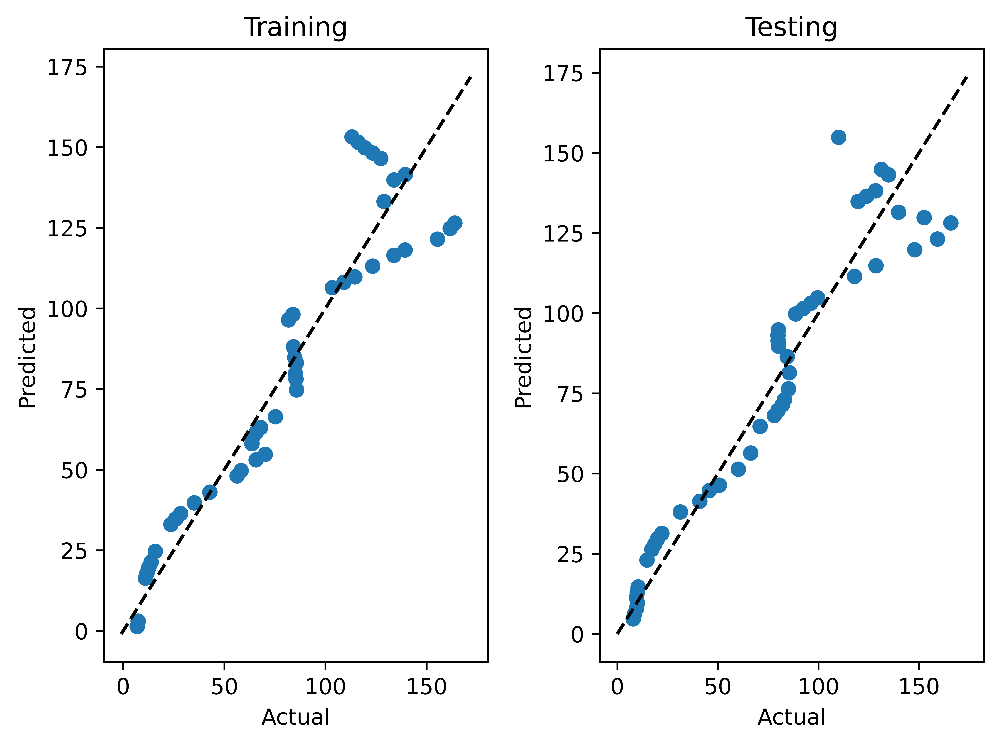

In [13]:
NeurNet(X,y_RU, 200)

## Polynomial Regression:

In [14]:
from sklearn.metrics import mean_squared_error

In [15]:
## Adapted from https://www.w3schools.com/python/python_ml_polynomial_regression.asp

def polynomial_regress(x, y, Country):
  for i in range(1,11):
    X_train, X_test, y_train, y_test = train_test_split(
      x, y, test_size=0.5, shuffle=True, random_state=0)
    polymodel = np.poly1d(np.polyfit(X_train, y_train, i))

    # x_line = np.linspace(1, X_test.size, 200)
    # z_line = np.linspace(1, y_test.size, y_test.size)

    figure(figsize=(8, 6), dpi=600)
    plt.scatter(X_test, y_test)
    plt.plot(X_test.sort_values(), polymodel(X_test.sort_values()), color='orange')
    plt.xlabel('Time')
    plt.ylabel('Ratio')
    plt.title(str(Country) + ' Ratio Polynomial Regression ('+str(i) + '-order)')
    plt.show()

    print('MSE=', mean_squared_error(y_test, polymodel(X_test)))

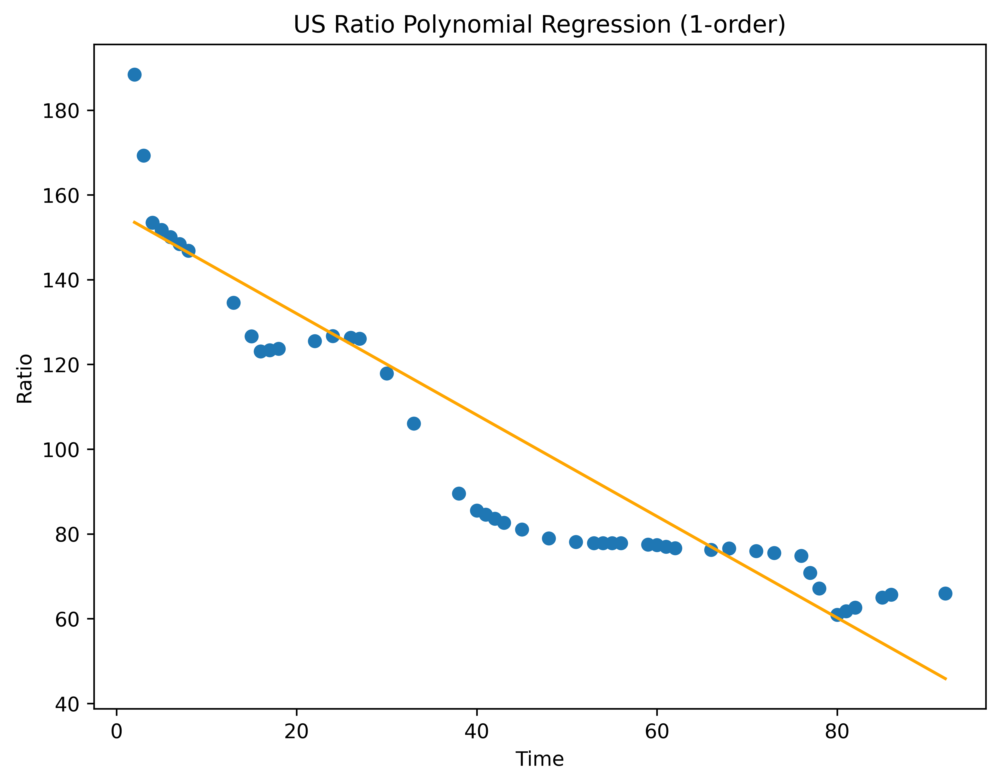

MSE= 161.1062144341352


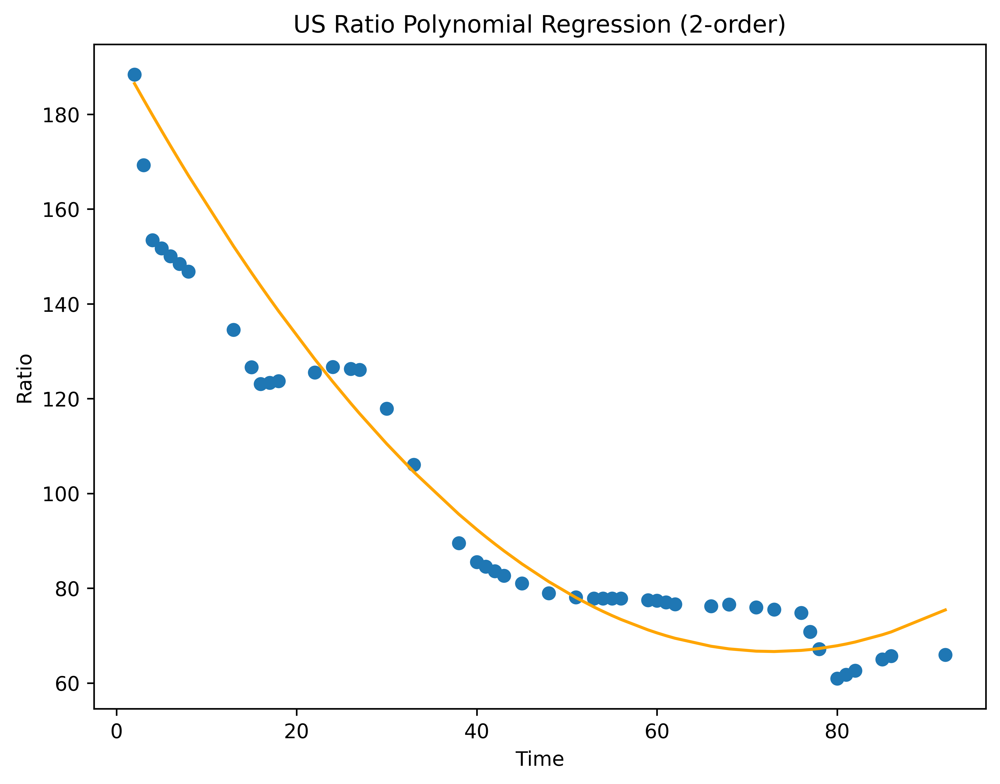

MSE= 125.8785483966254


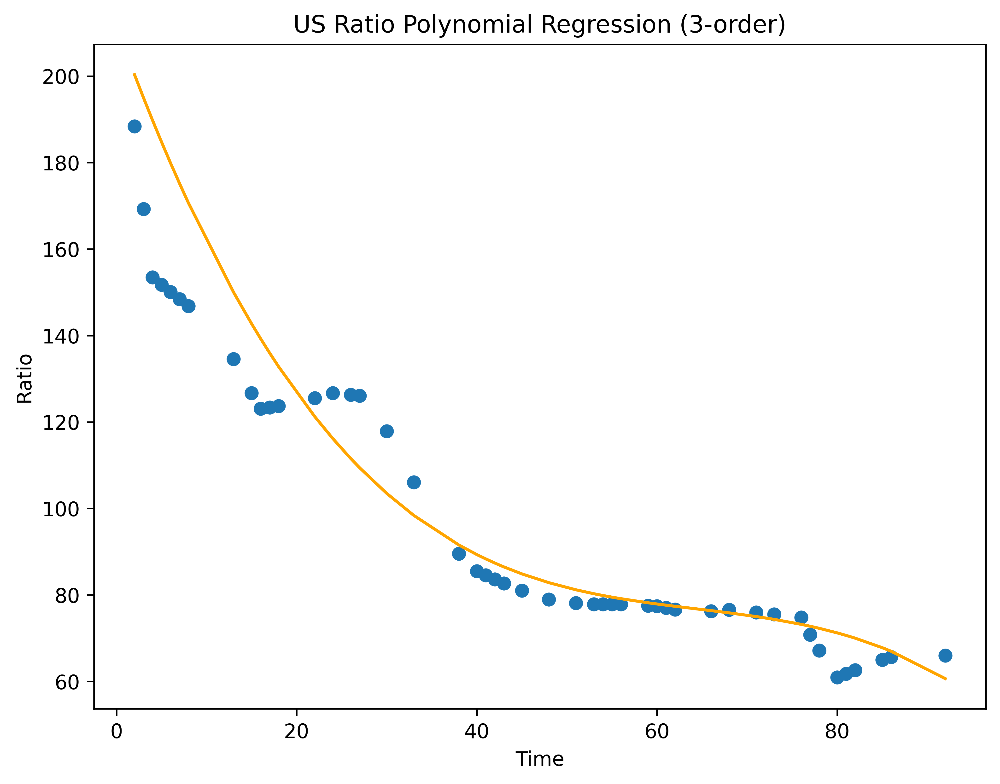

MSE= 163.9837368881532


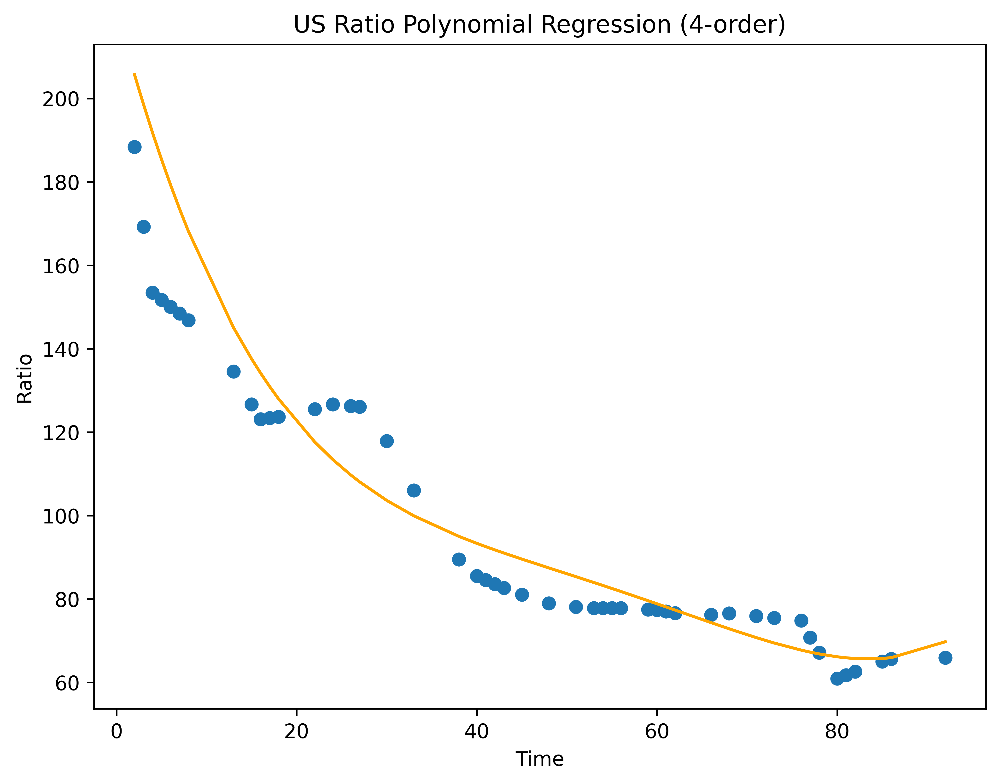

MSE= 170.49588837647346


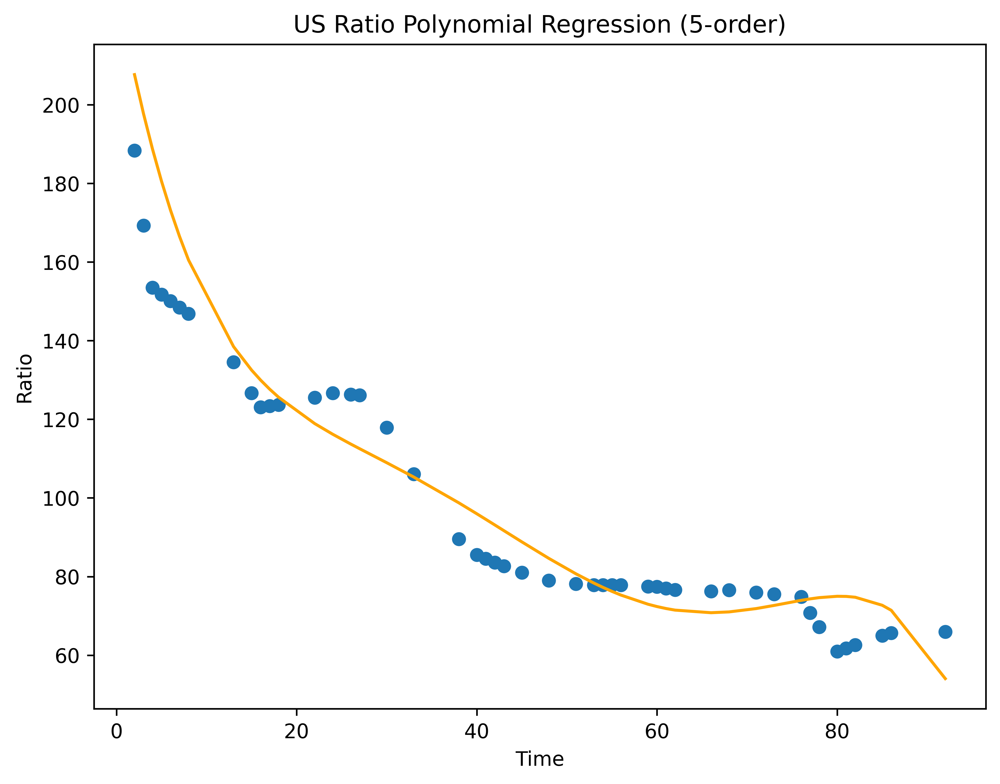

MSE= 139.94737104415768


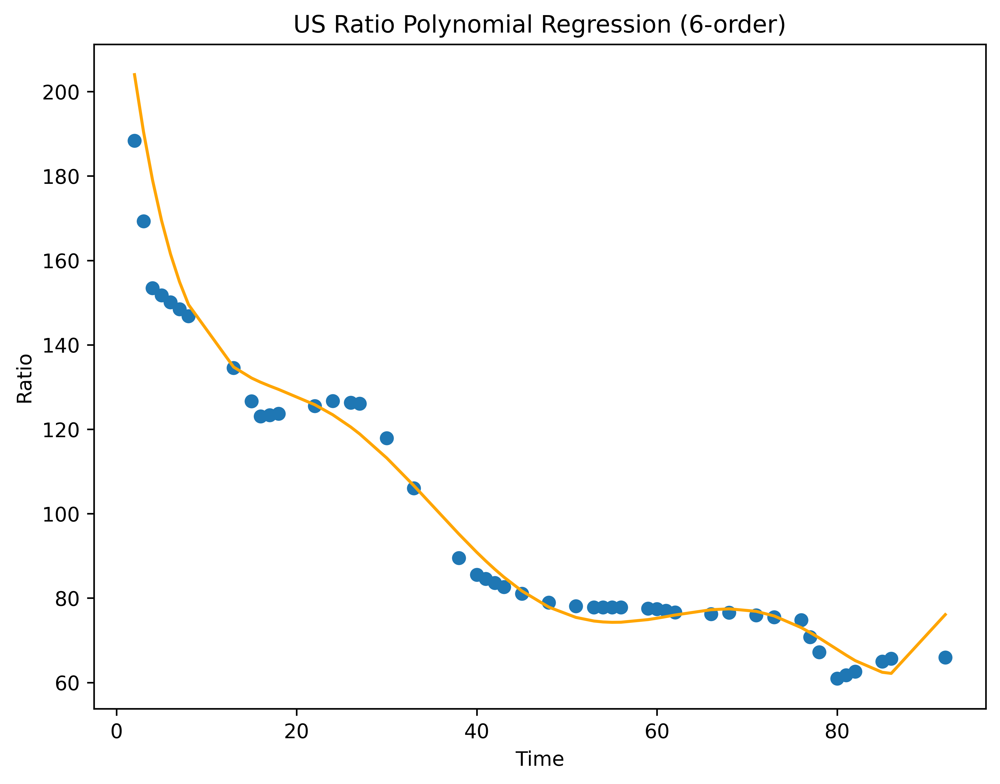

MSE= 53.626548342270574


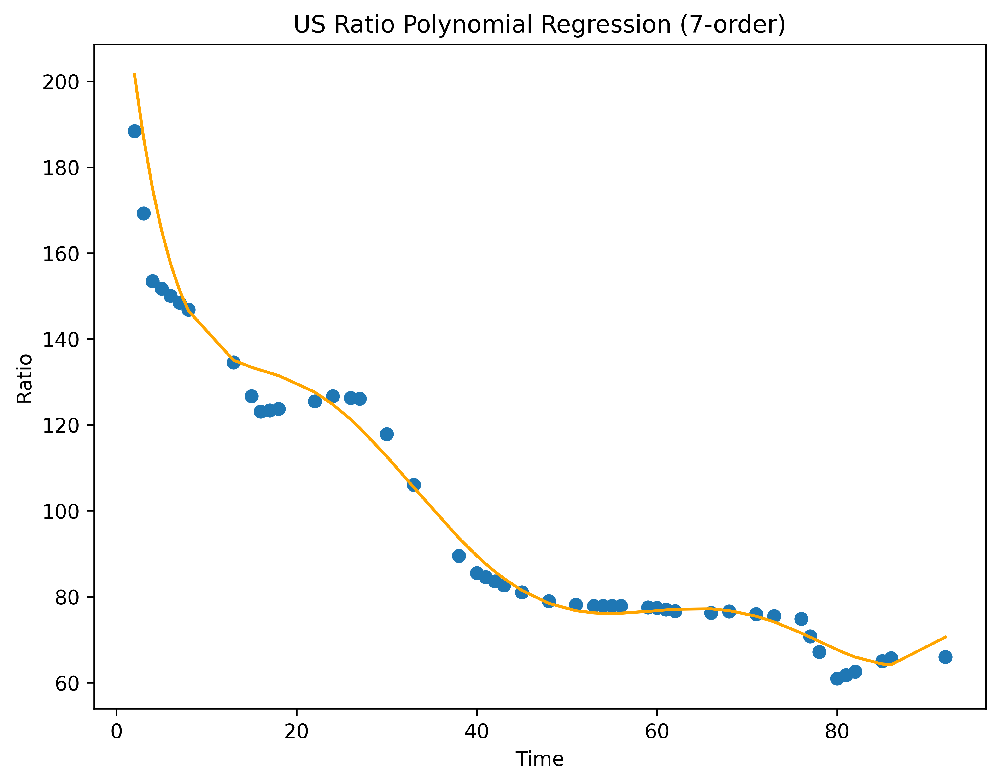

MSE= 37.76482845107106


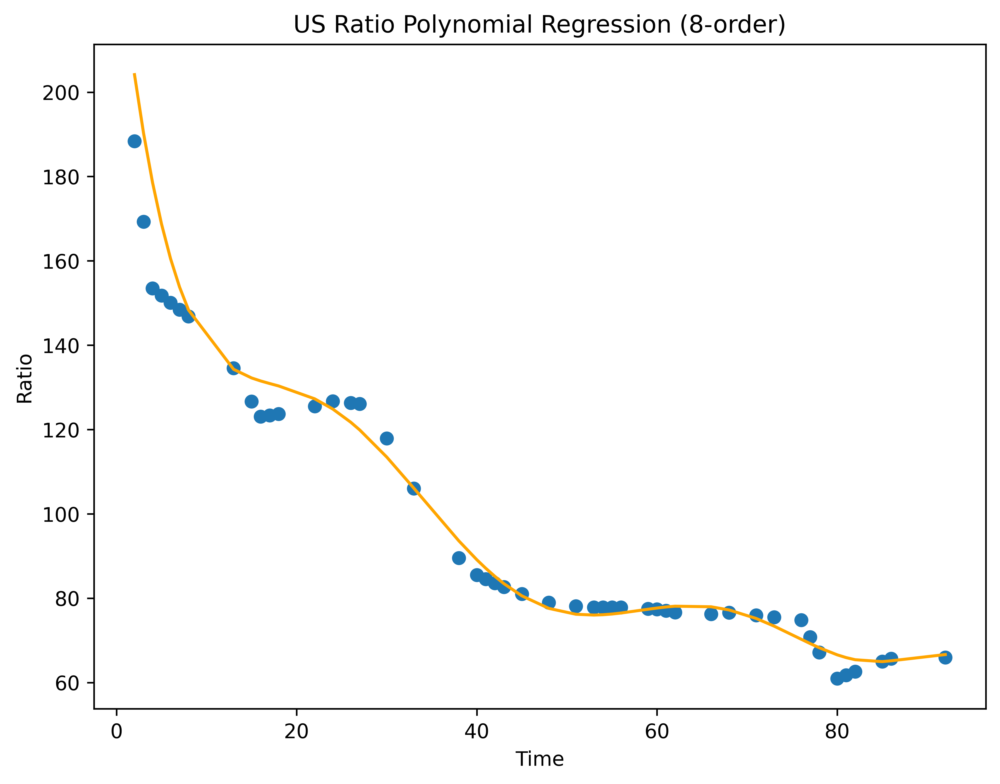

MSE= 46.593958886954866


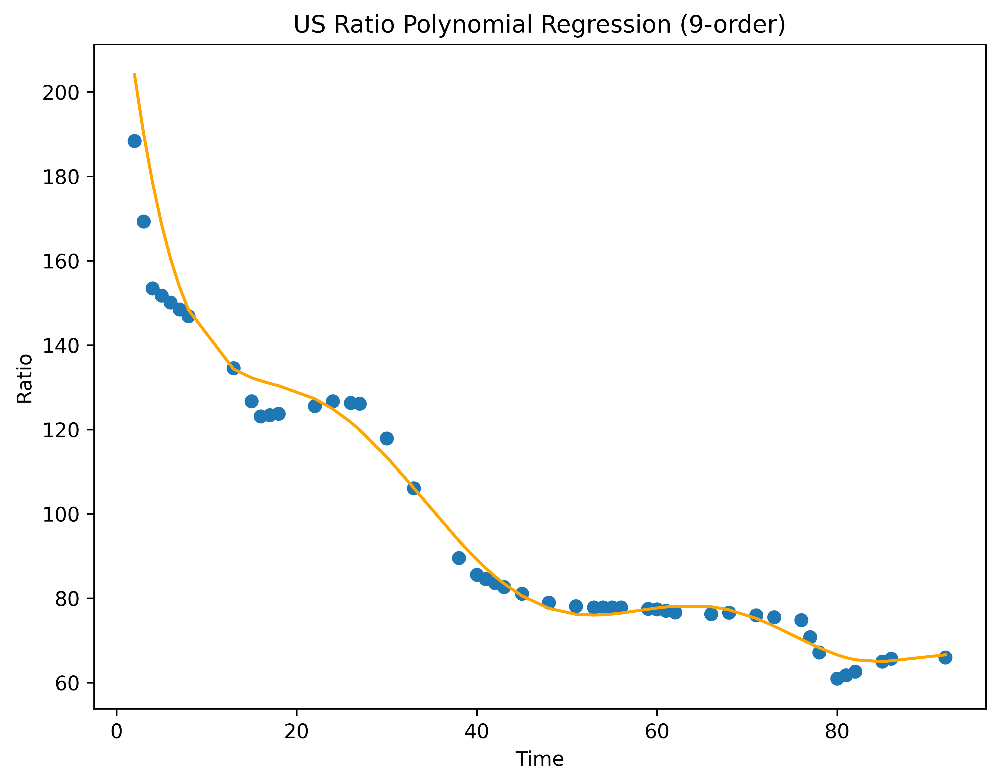

MSE= 46.332966271868365


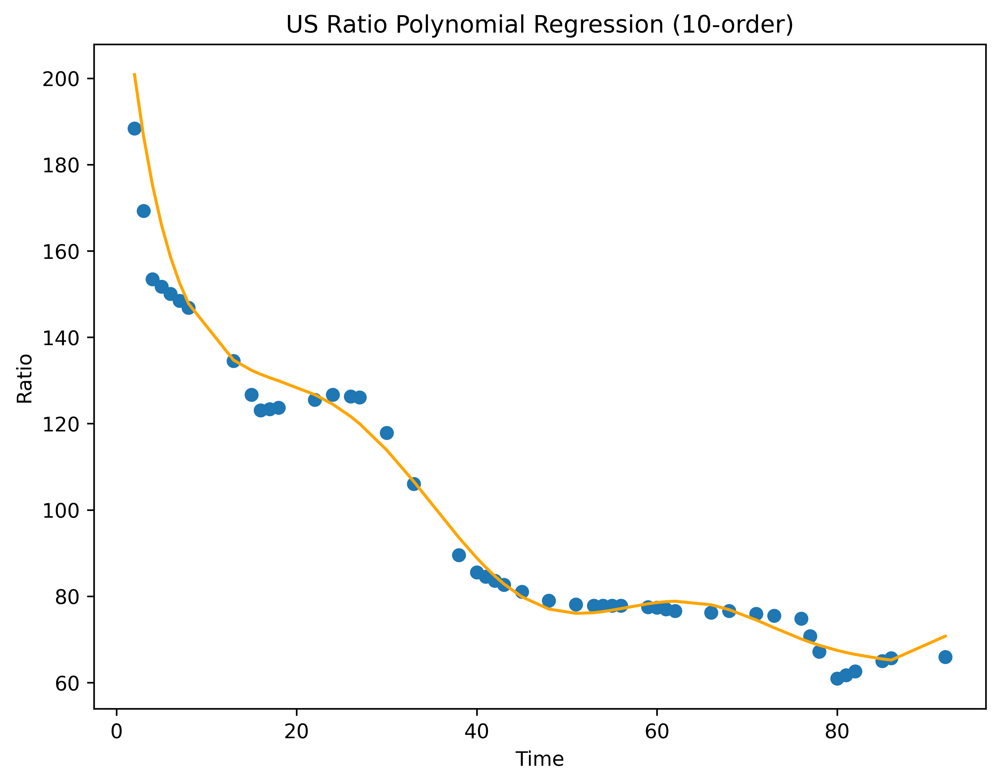

MSE= 36.31899763092398


In [16]:
polynomial_regress(X, y_US, 'US')

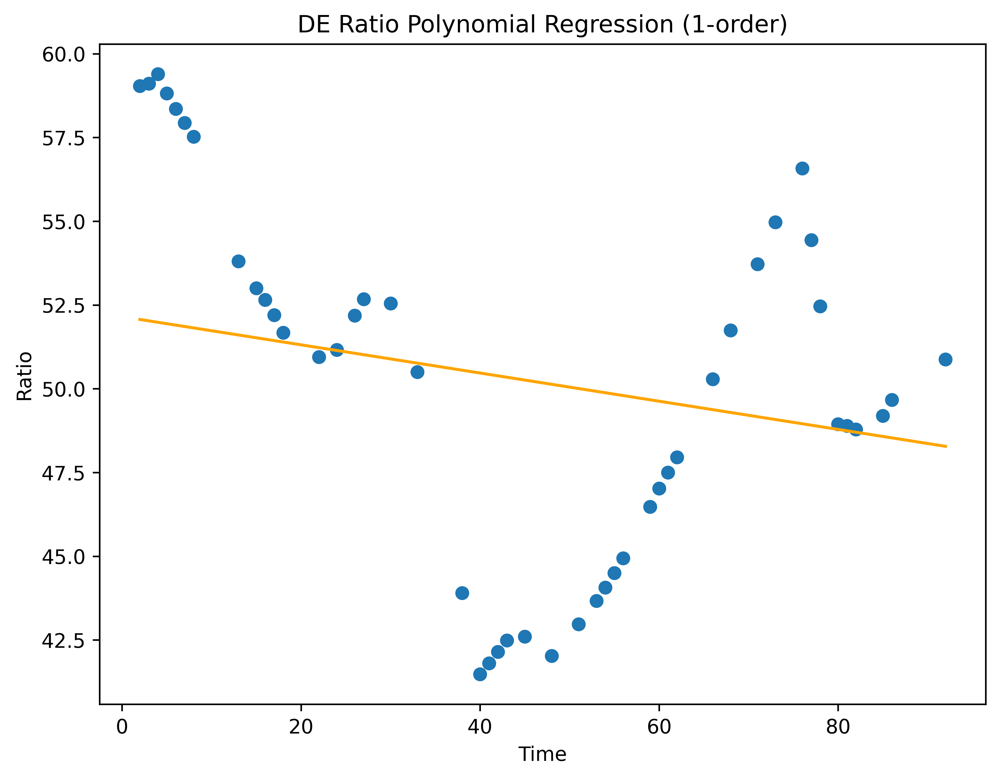

MSE= 24.518192086714283


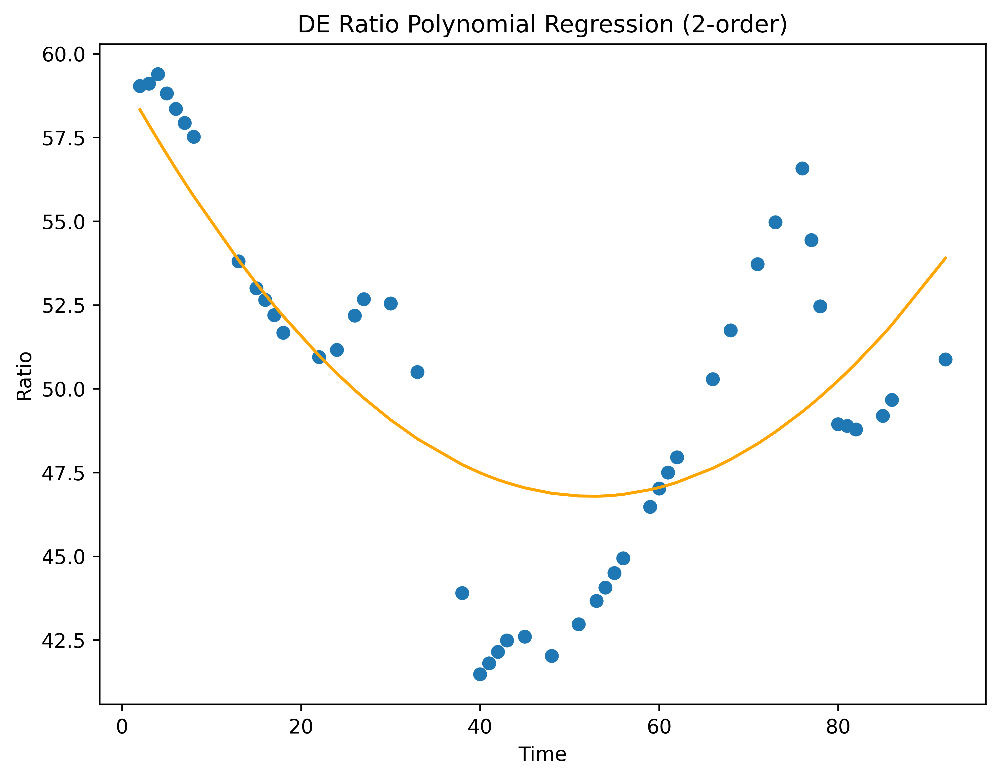

MSE= 9.939358674978125


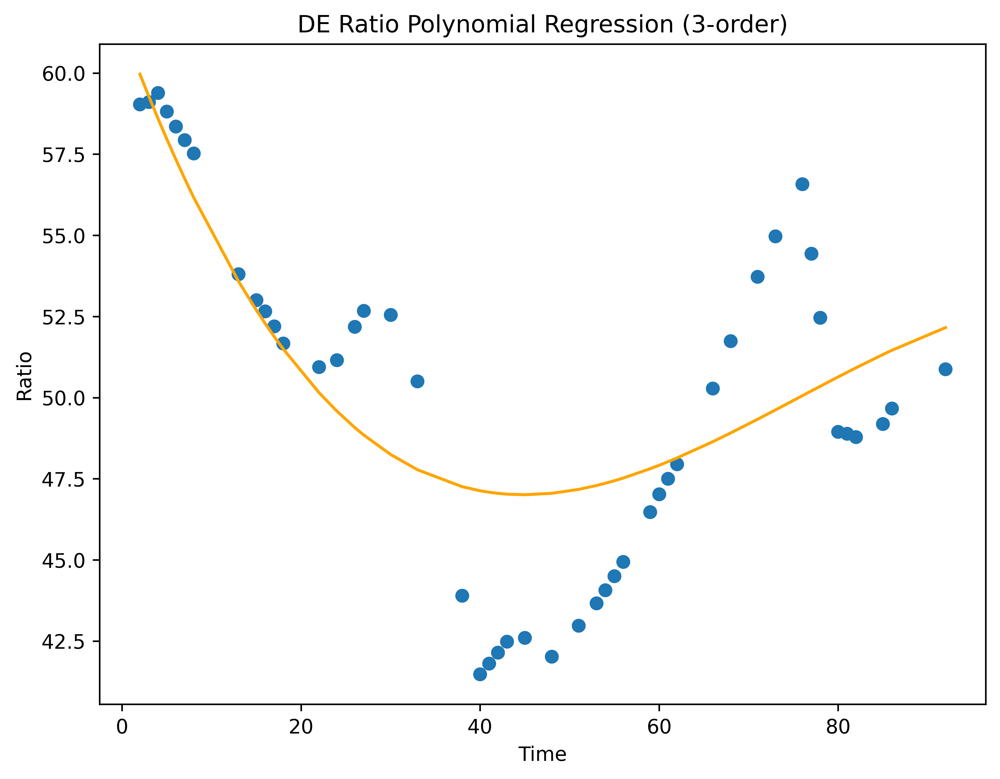

MSE= 9.029341805093551


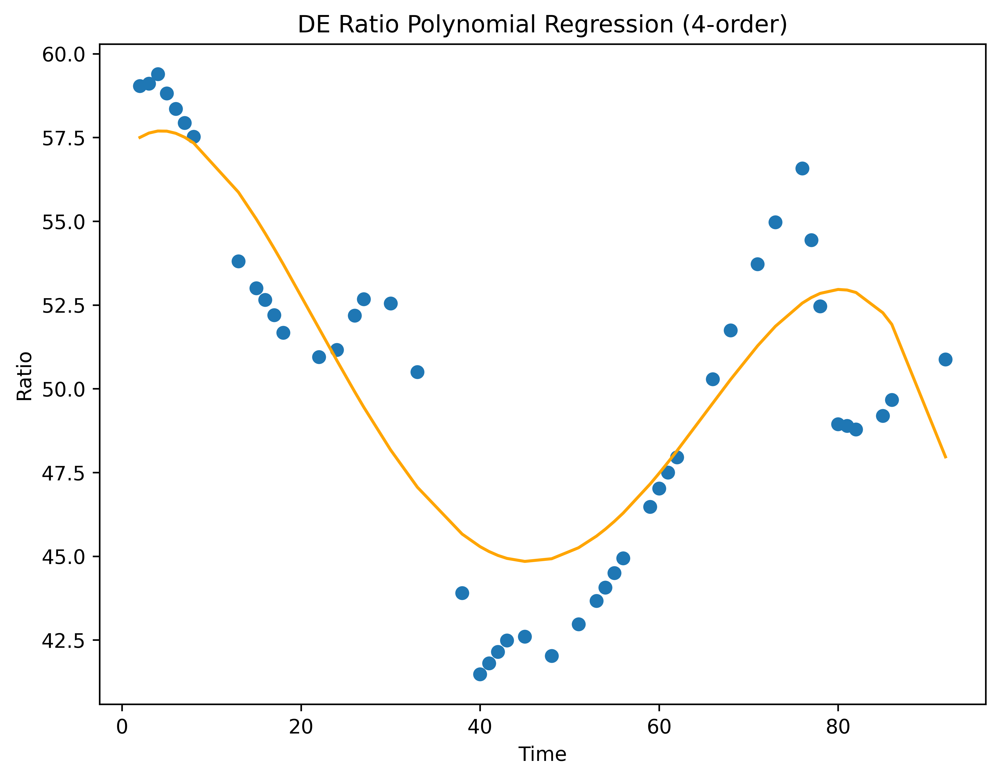

MSE= 5.547280643447895


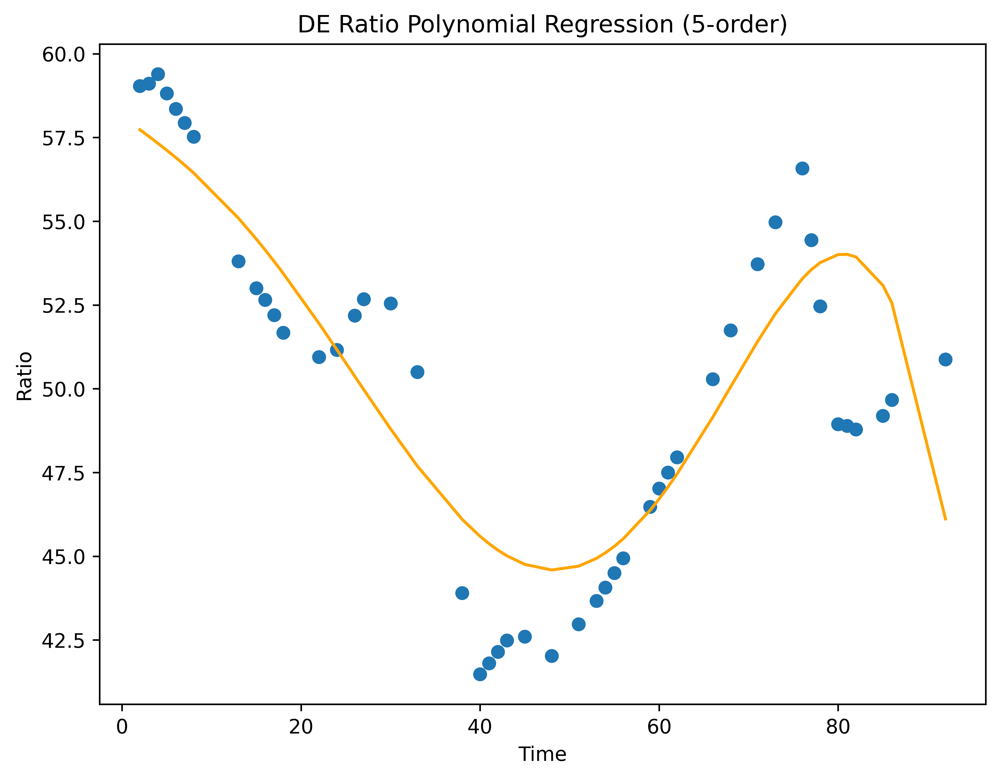

MSE= 6.060595182578354


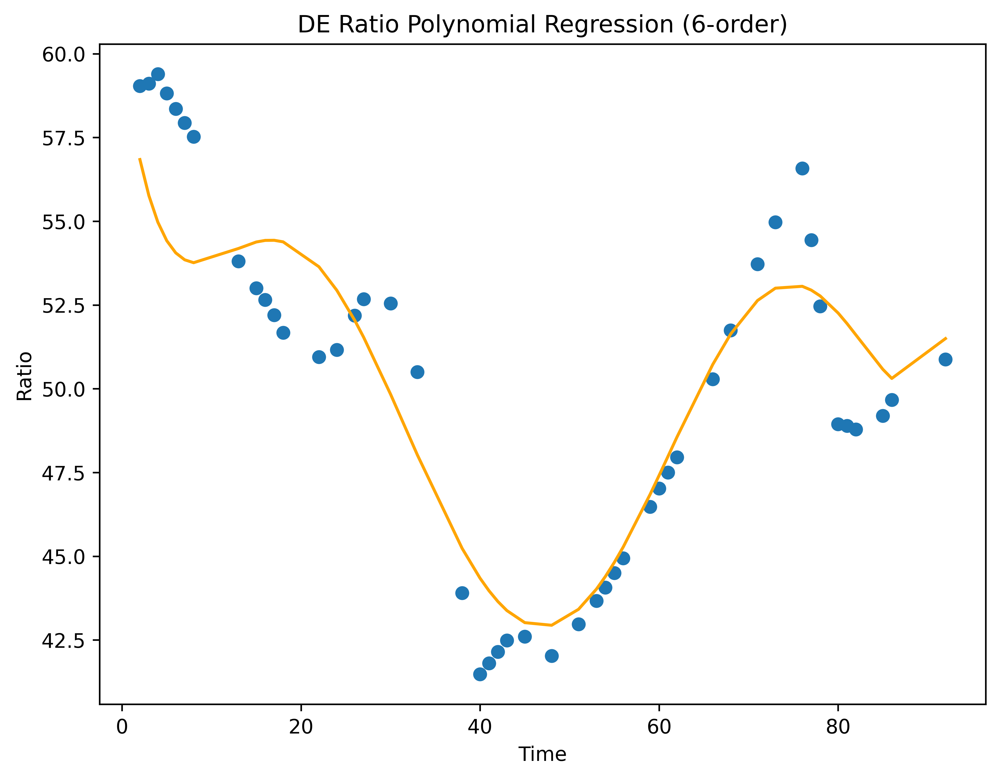

MSE= 4.643787851182399


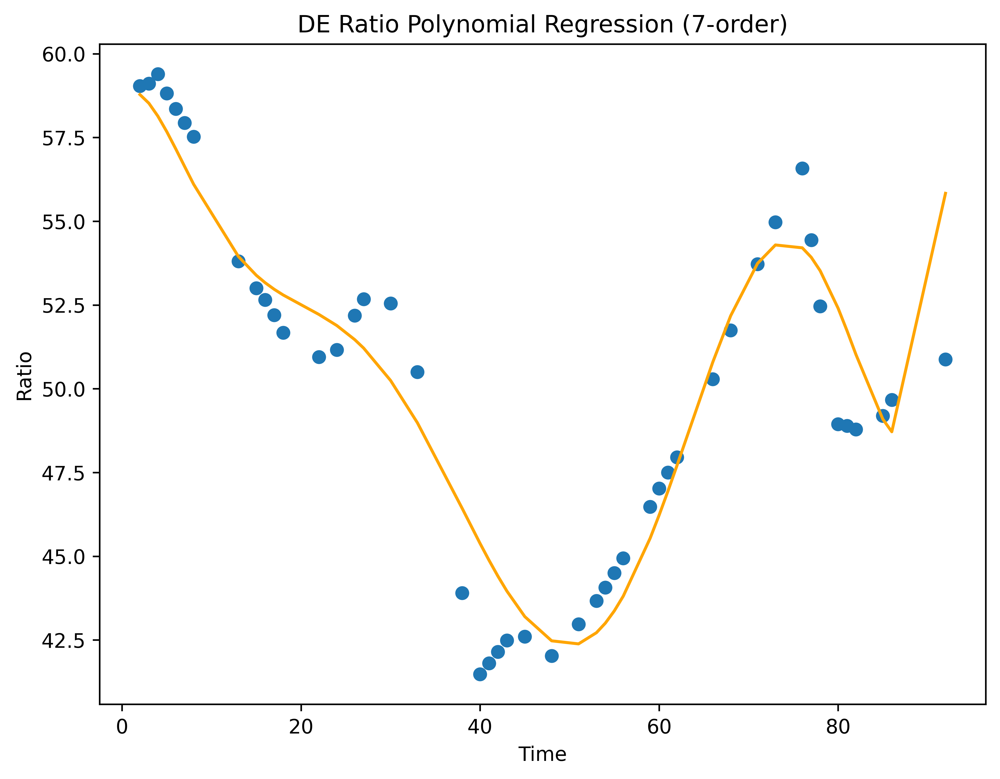

MSE= 2.709274943085515


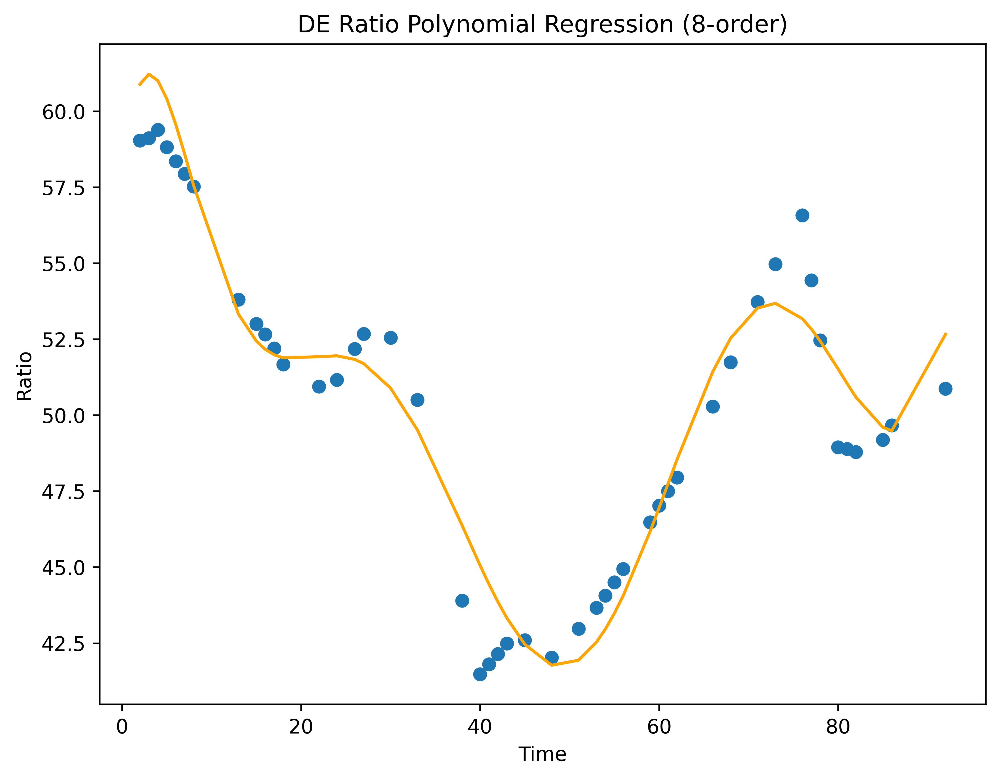

MSE= 1.9861494634761885


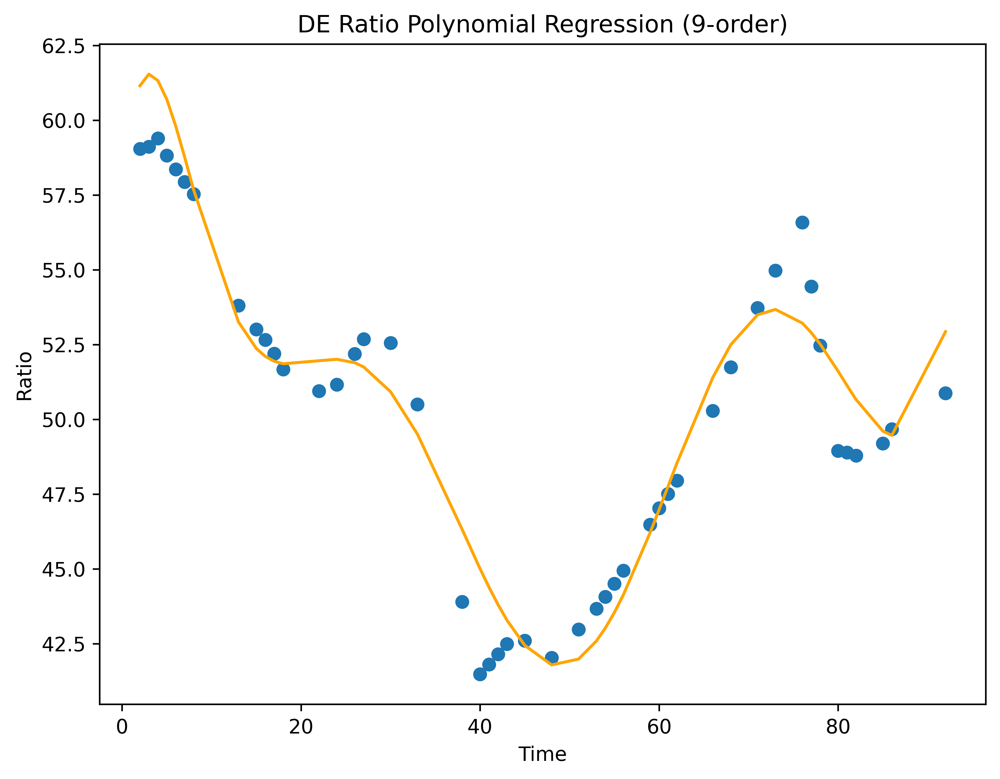

MSE= 2.1017671037134837


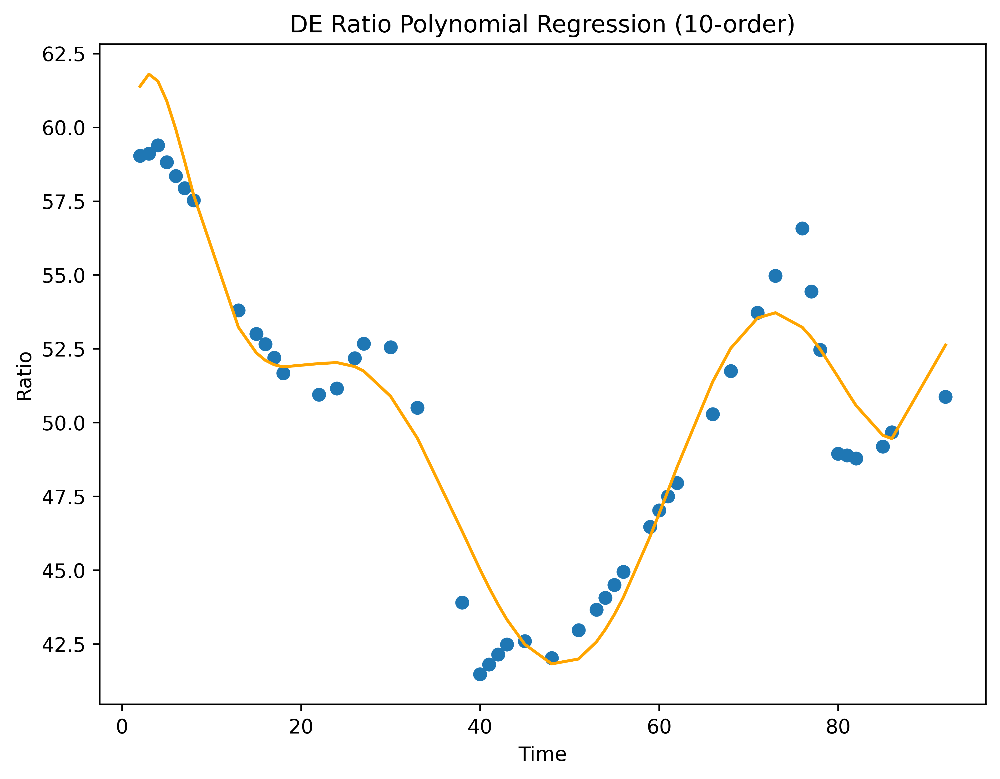

MSE= 2.173126852423349


In [17]:
polynomial_regress(X, y_DE, 'DE')

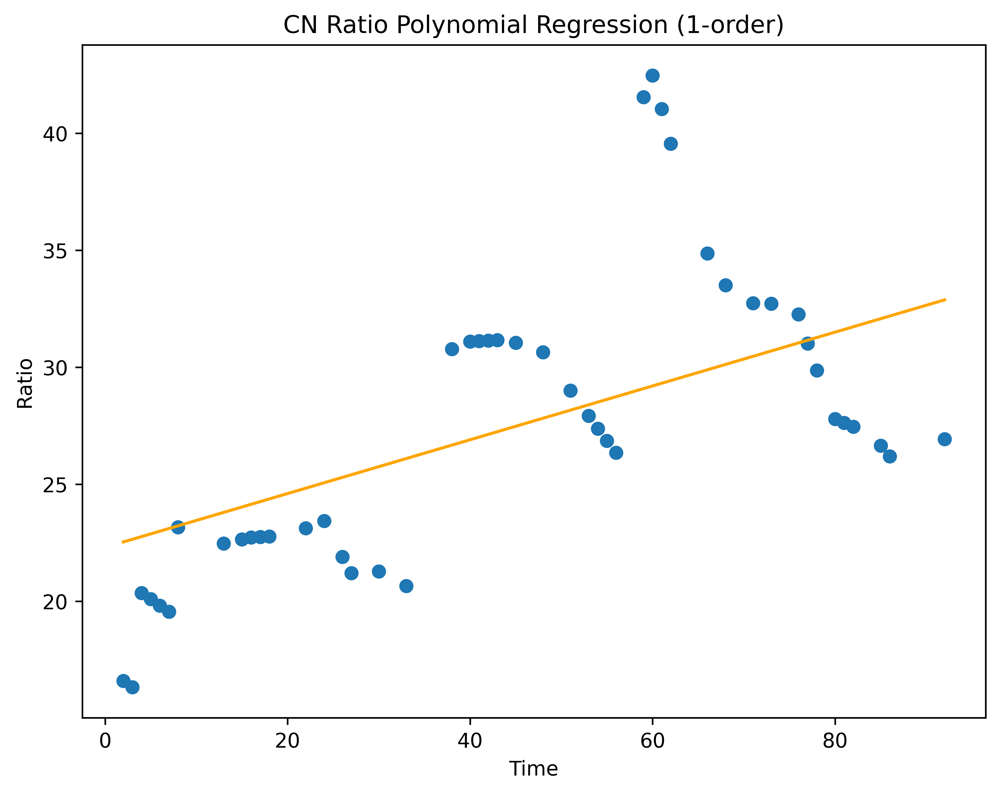

MSE= 23.182014843602914


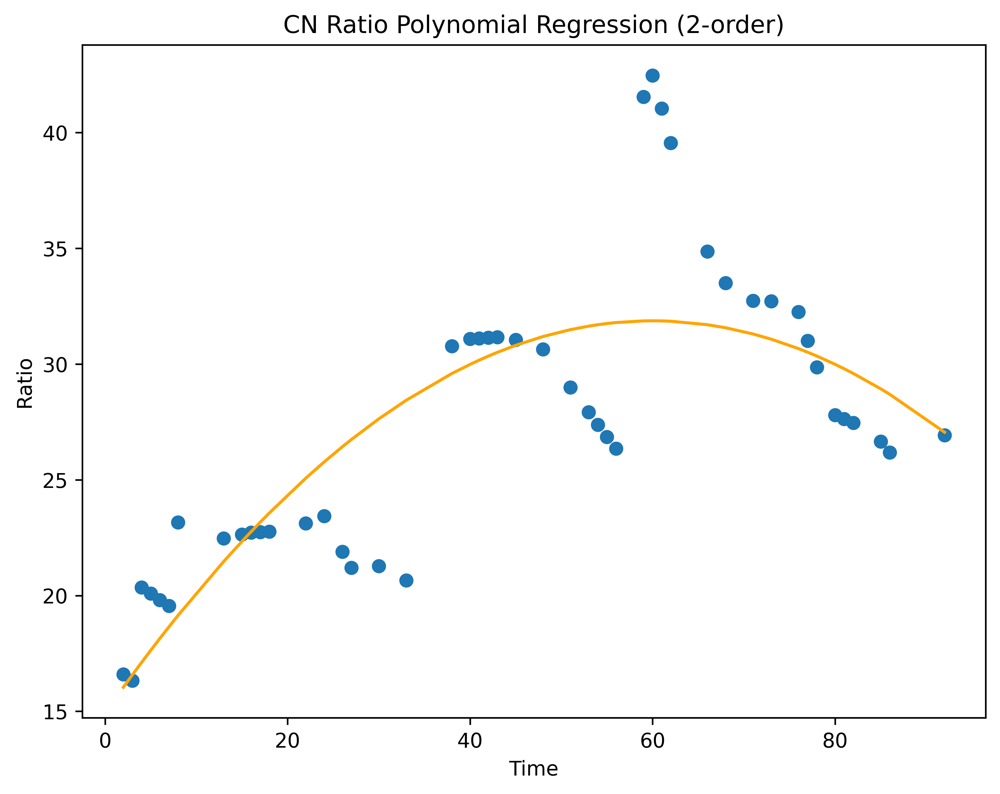

MSE= 14.761407714222775


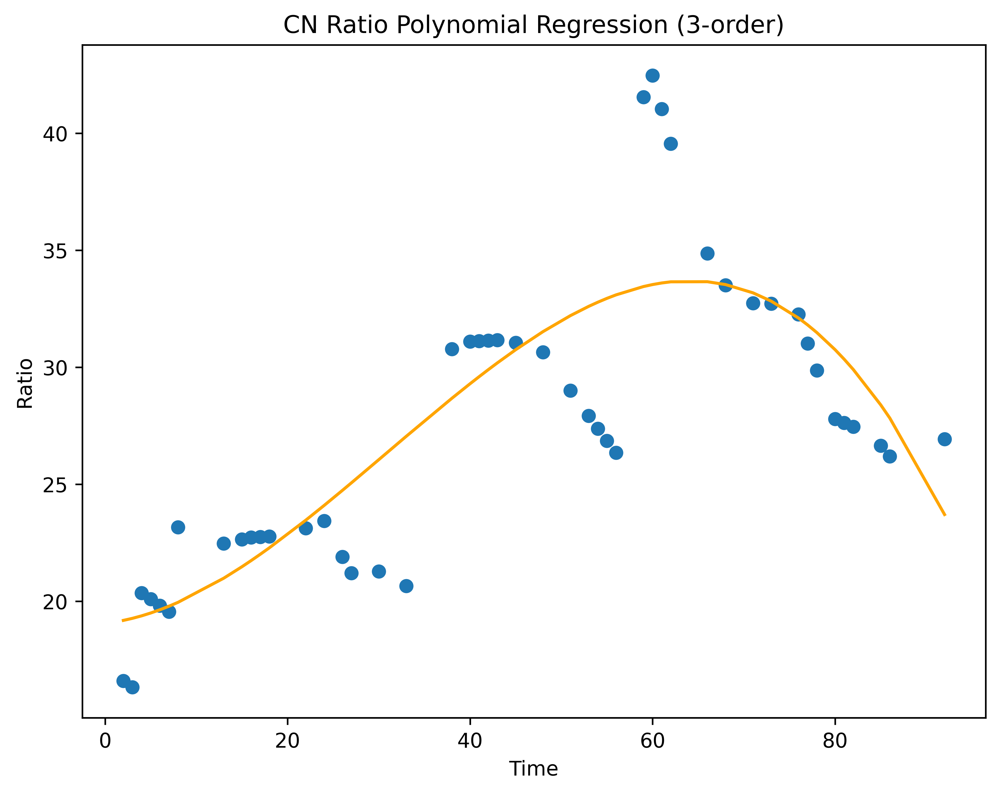

MSE= 11.816524828233401


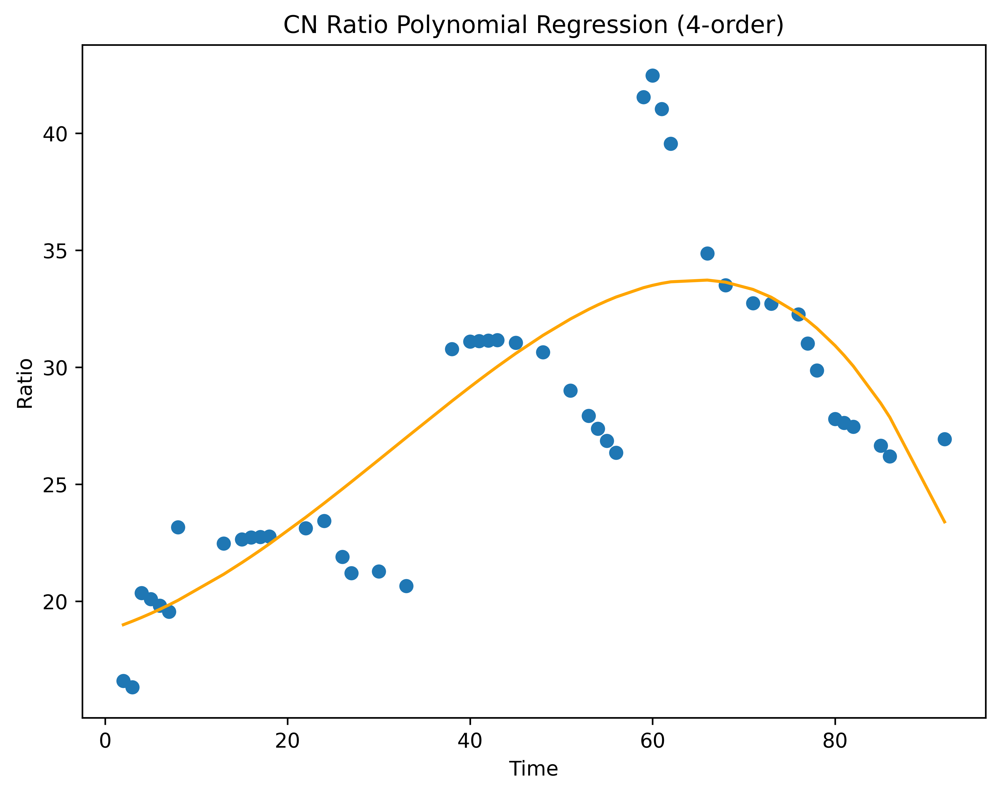

MSE= 11.833180179682312


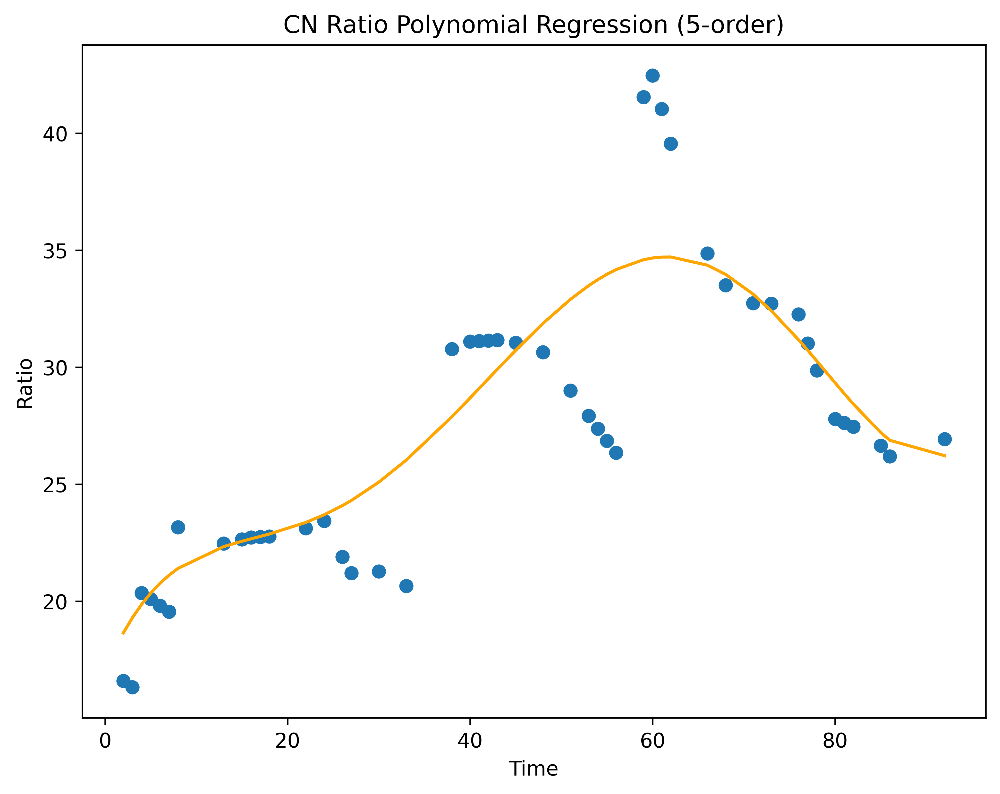

MSE= 10.242910406917899


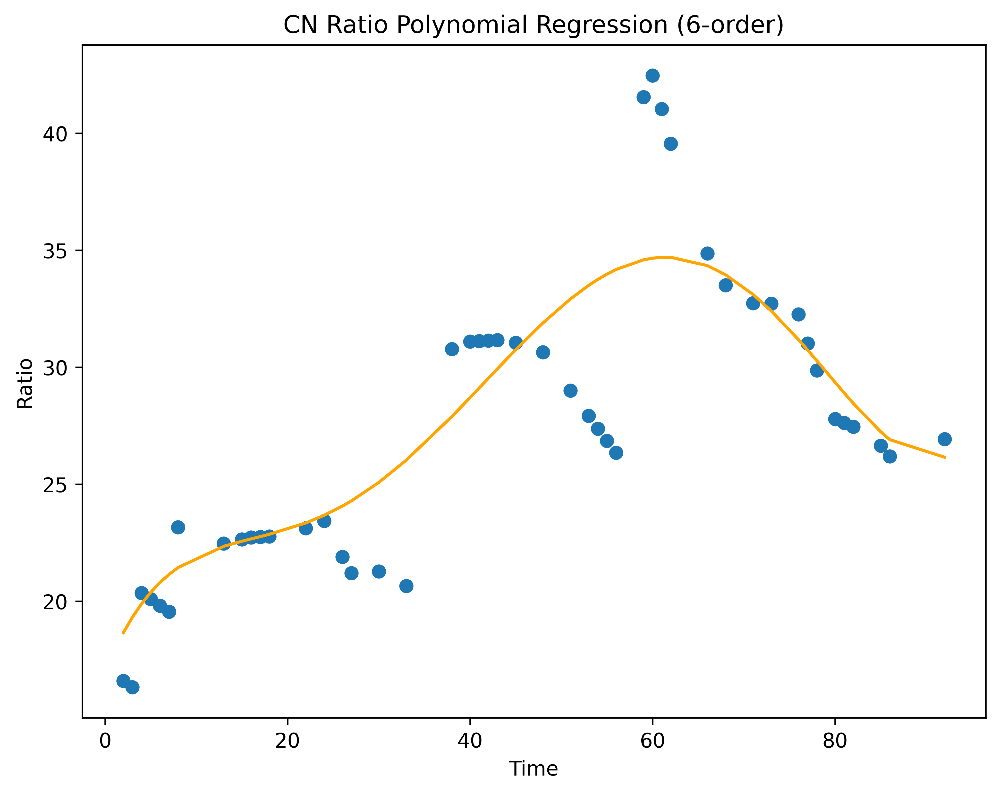

MSE= 10.262241425398798


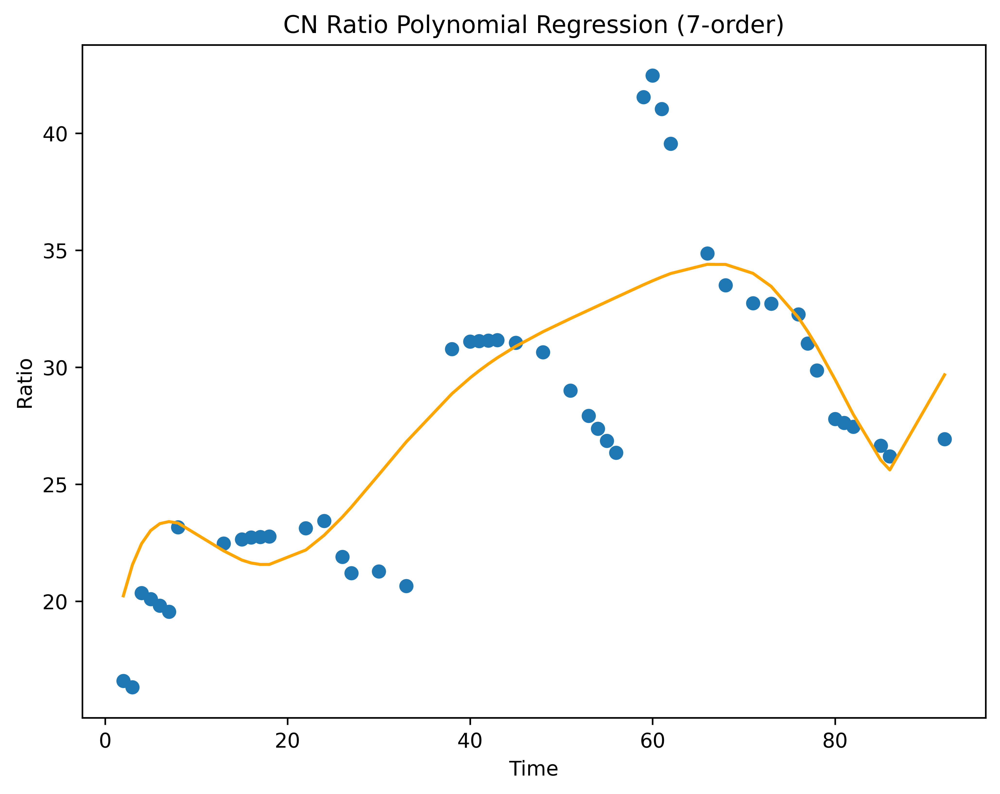

MSE= 11.49412485818484


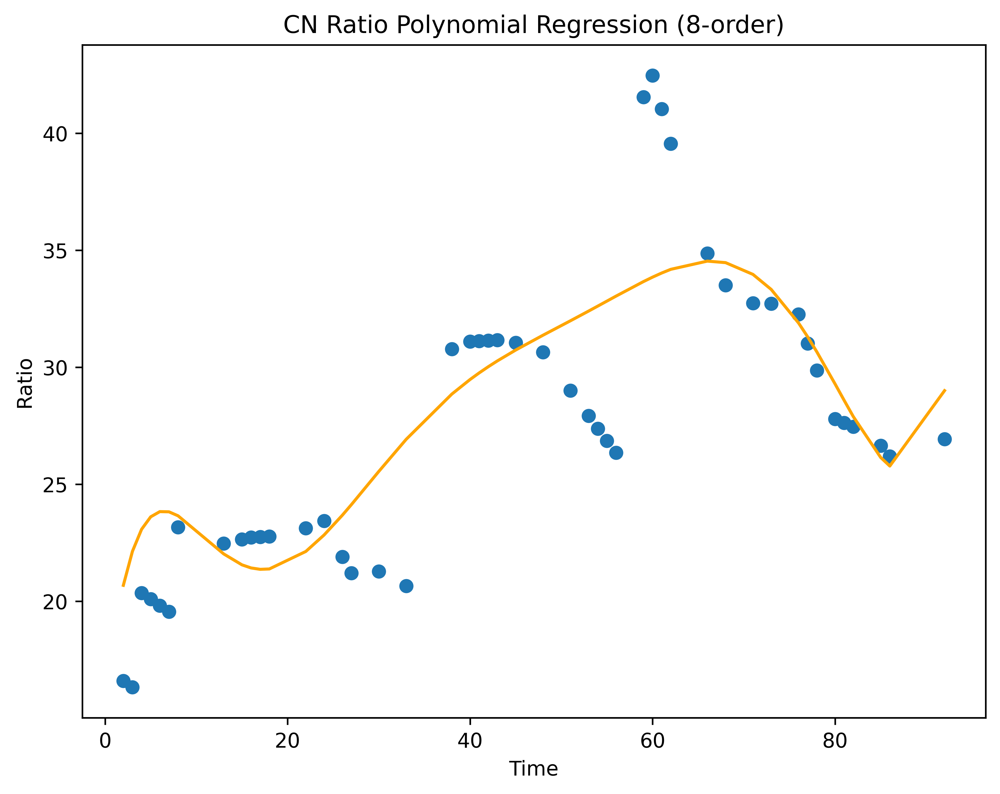

MSE= 11.83257641730939


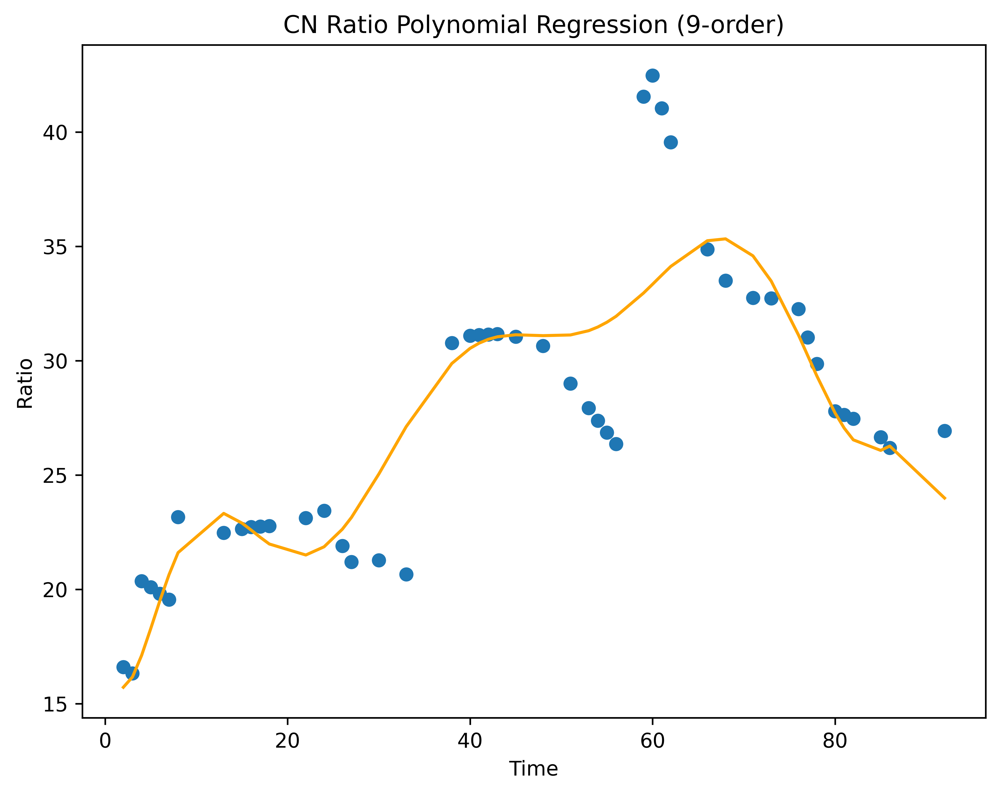

MSE= 9.228225571768741


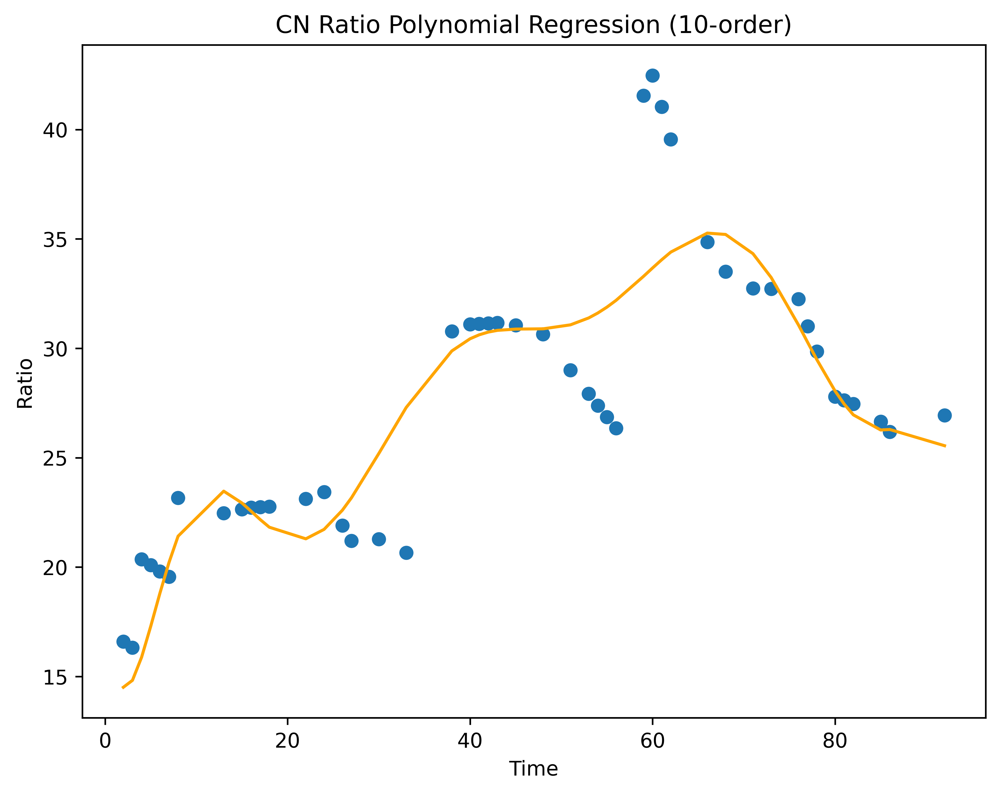

MSE= 9.323538651301591


In [18]:
polynomial_regress(X, y_CN, 'CN')

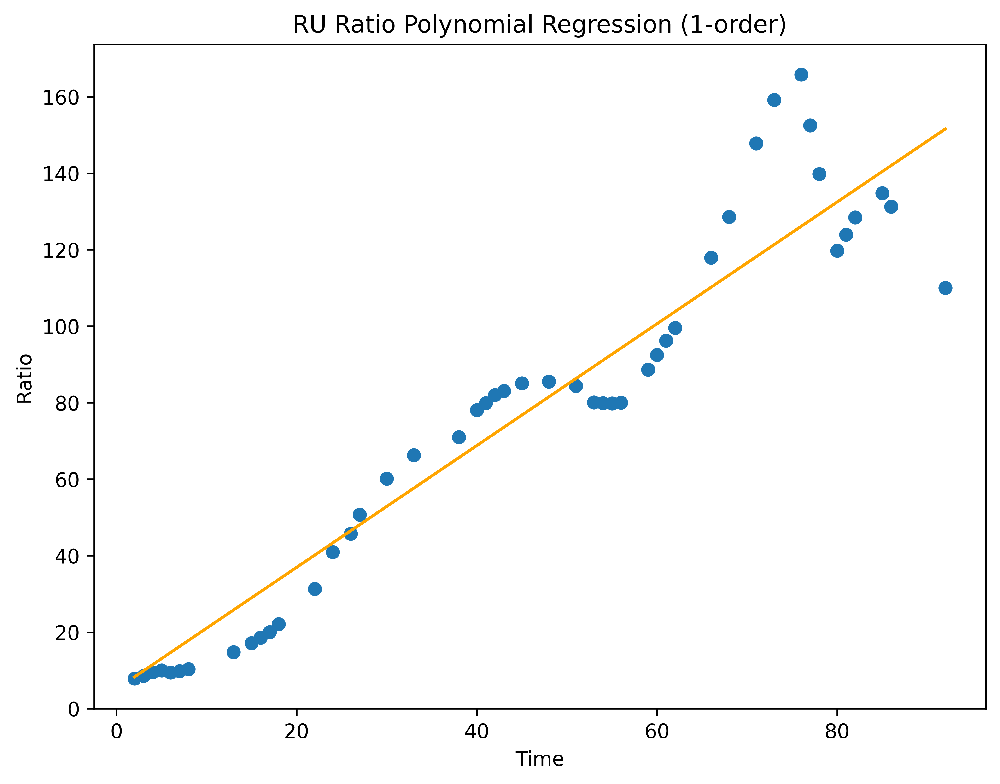

MSE= 200.86314714080038


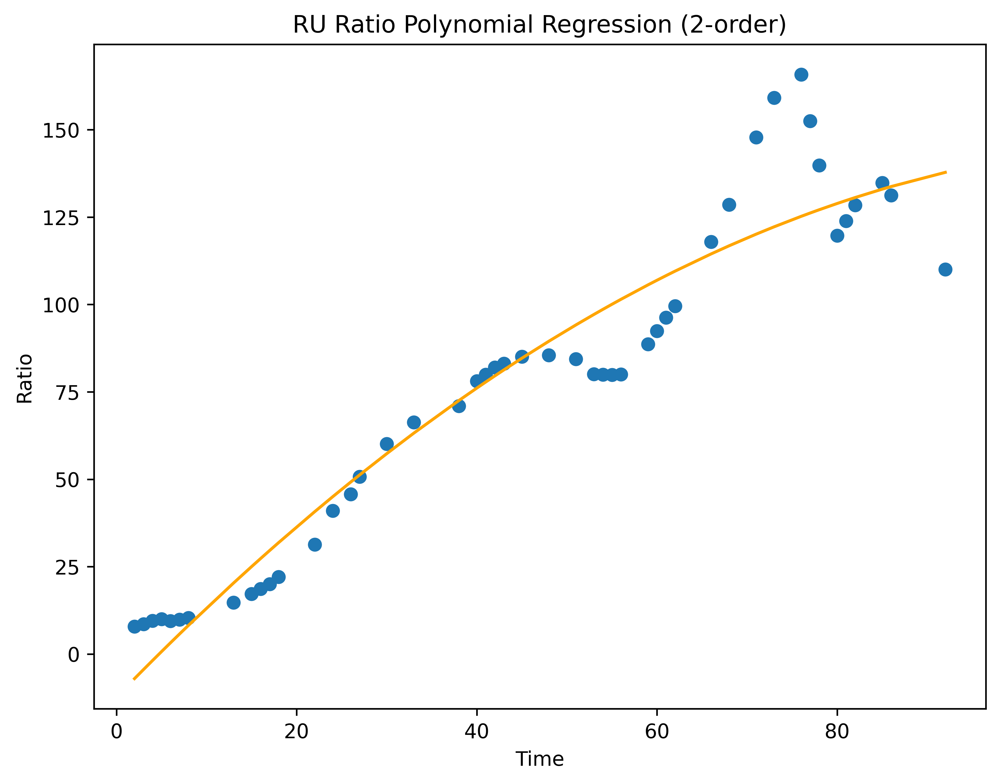

MSE= 196.3460848321263


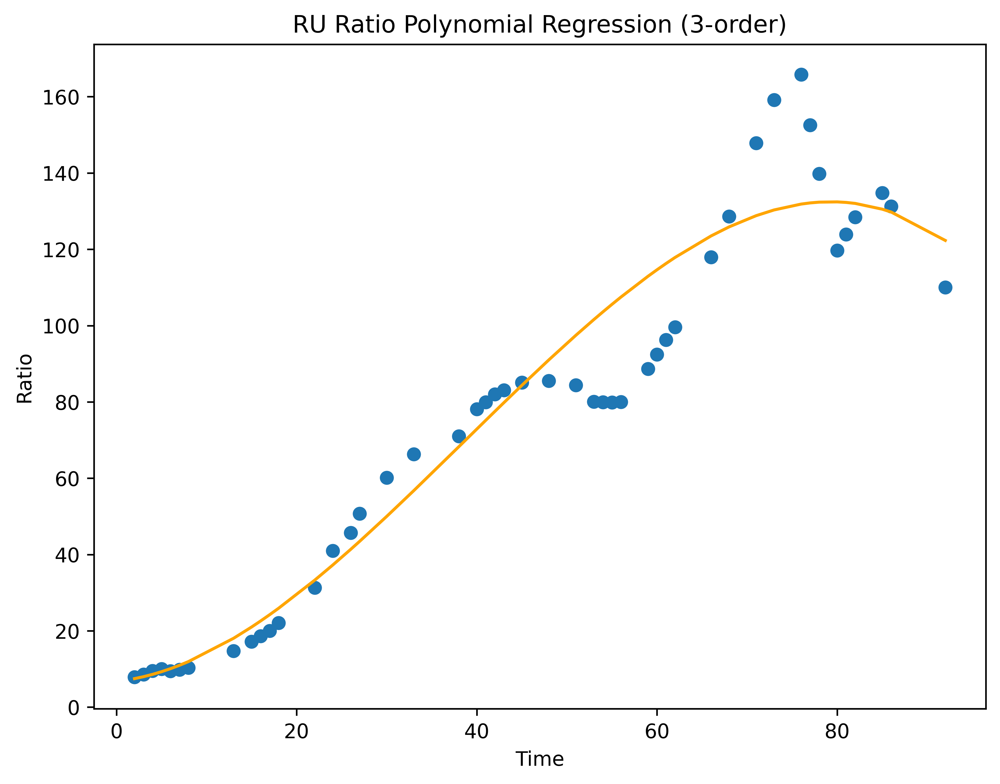

MSE= 174.0184259542907


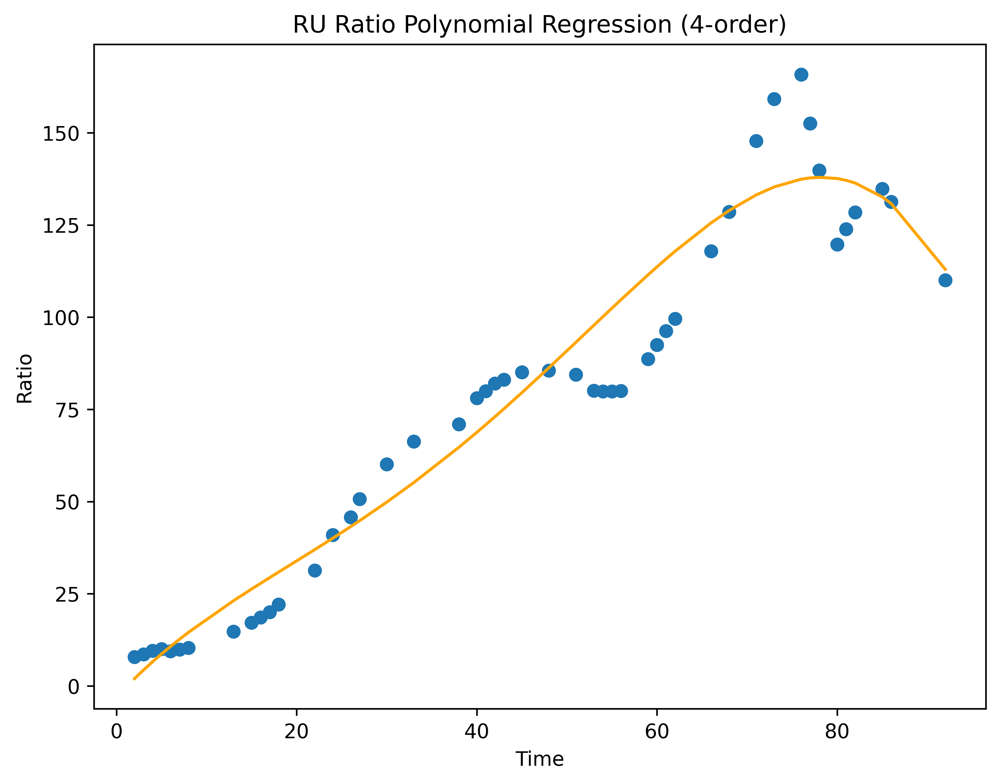

MSE= 153.86457632469265


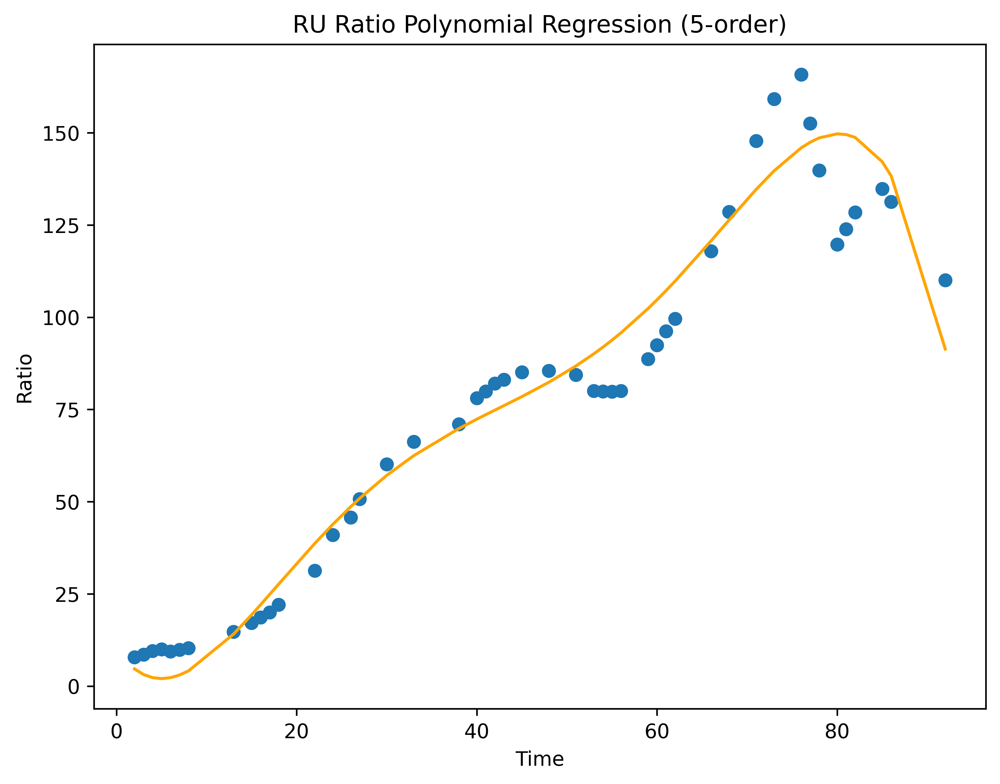

MSE= 115.41931540340975


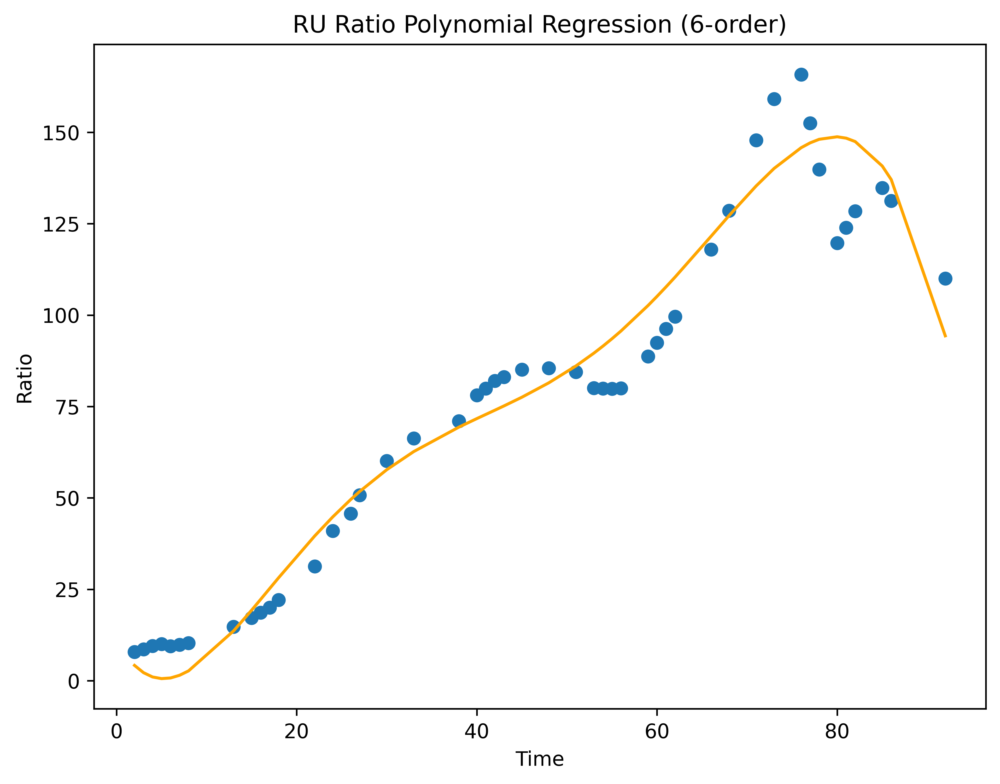

MSE= 113.4481070143003


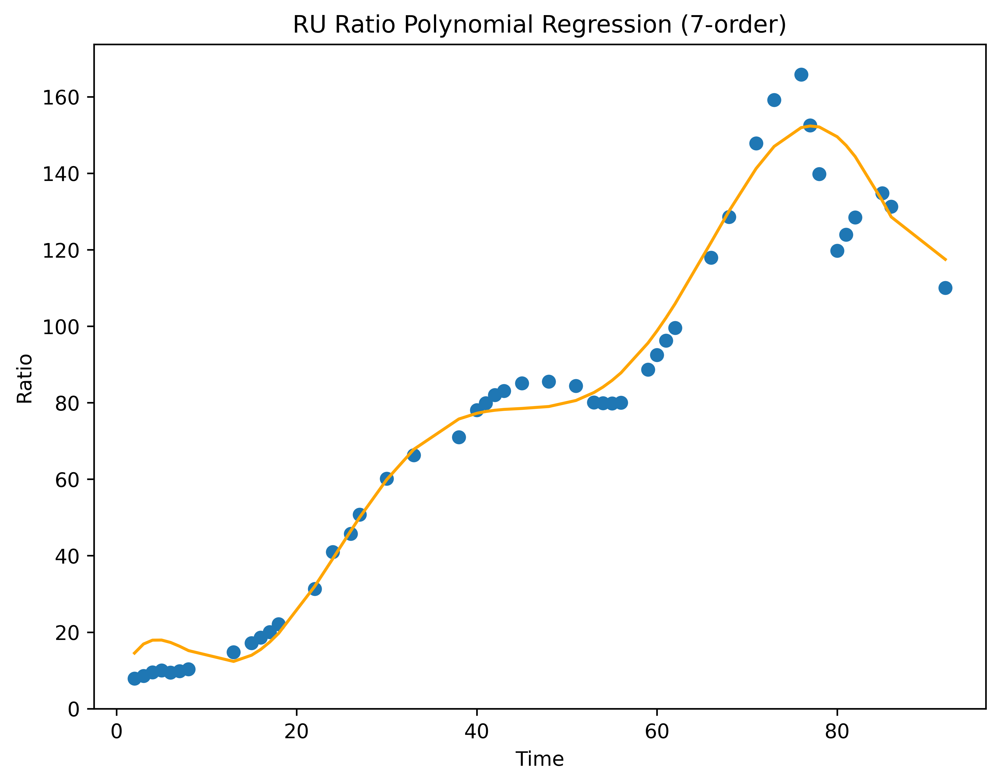

MSE= 67.62588907673545


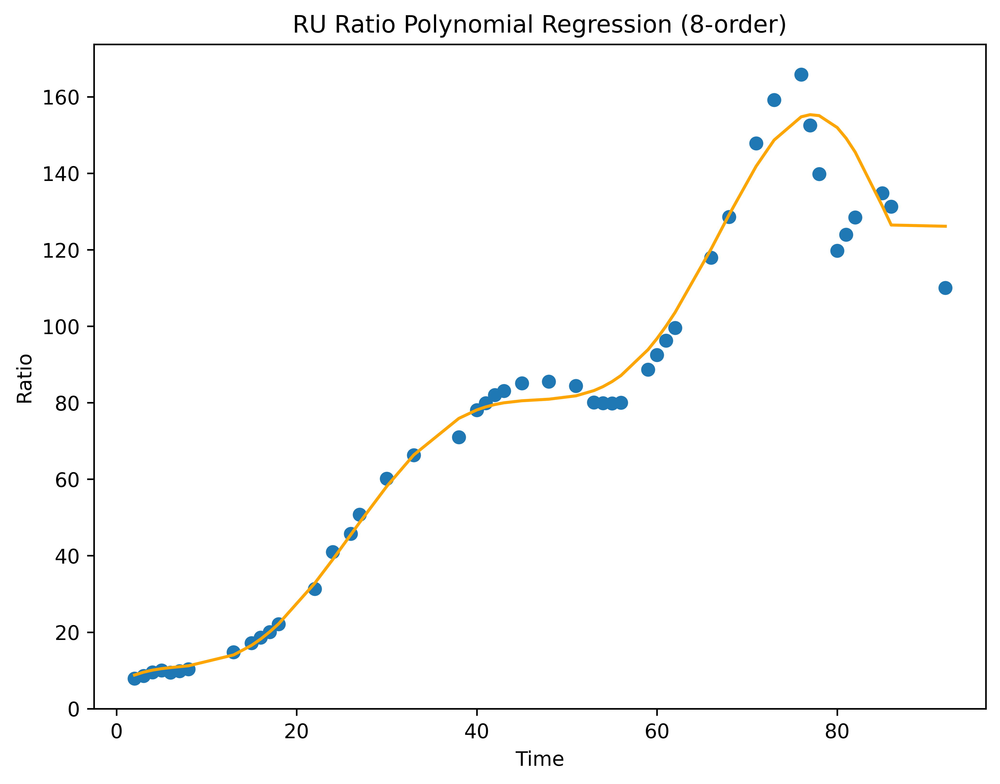

MSE= 65.33296792136639


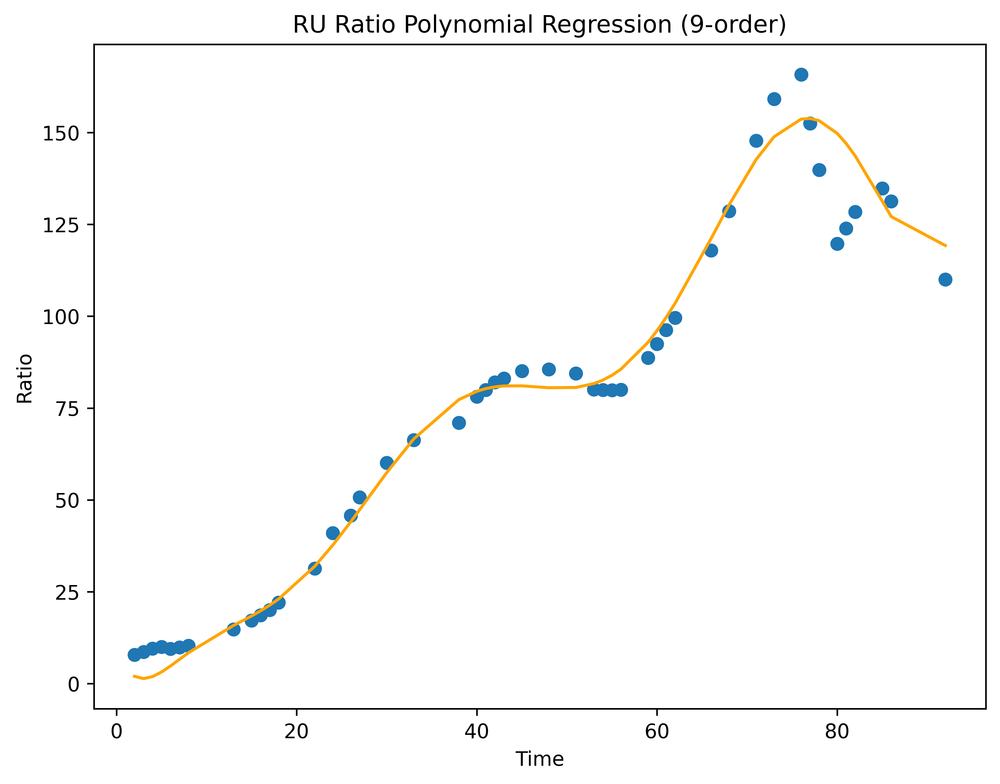

MSE= 58.38386179755985


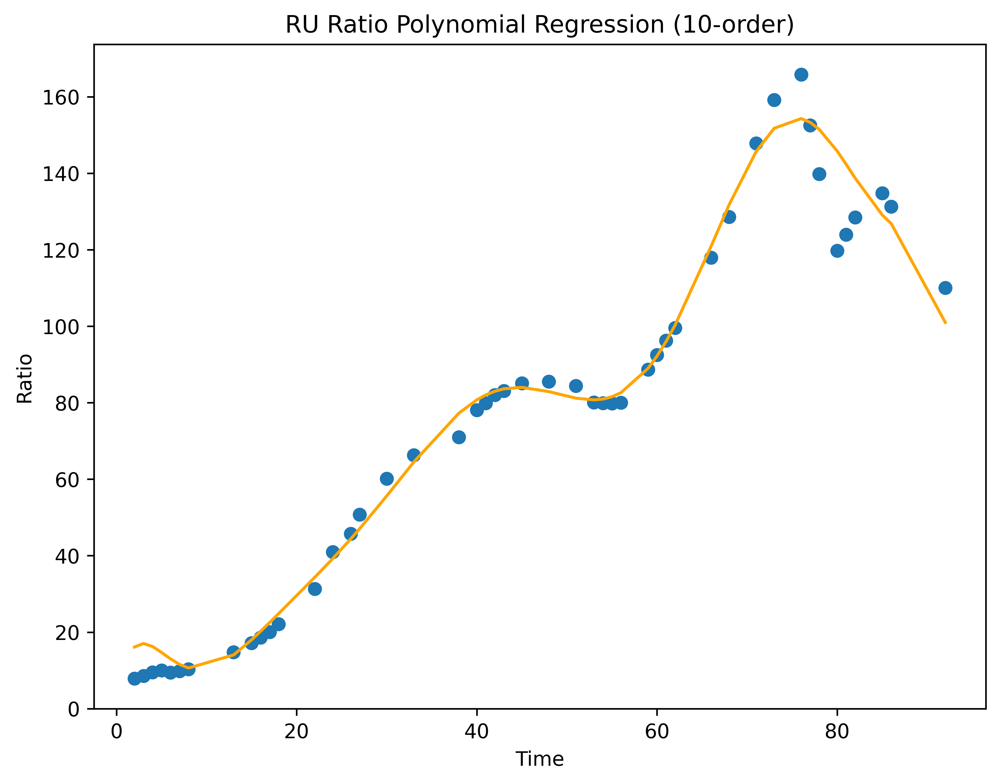

MSE= 42.110228996263466


In [19]:
polynomial_regress(X, y_RU, 'RU')

## Cubic spline regression:

In [20]:
## Inspired by https://docs.scipy.org/doc/scipy/reference/generated/scipy.interpolate.CubicSpline.html

from sklearn.metrics import mean_squared_error
from scipy.interpolate import CubicSpline
import matplotlib.pyplot as plt

def cubic(x, y, Country):
  X_train, X_test, y_train, y_test = train_test_split(
        x, y, test_size=0.5, shuffle=True, random_state=0)
  cs = CubicSpline(X_train.sort_values(), y_train.sort_index(ascending=True))
  cs(X_test)

  figure(figsize=(8, 6), dpi=600)
  plt.scatter(X_test, y_test)
  plt.plot(X_test.sort_values(), cs(X_test.sort_values()), color='orange')
  plt.xlabel('Time')
  plt.ylabel('Ratio')
  plt.title(' Cubic Spline Regression ('+ str(Country) +')')
  plt.show()

  print('MSE=', mean_squared_error(y_test, cs(X_test)))

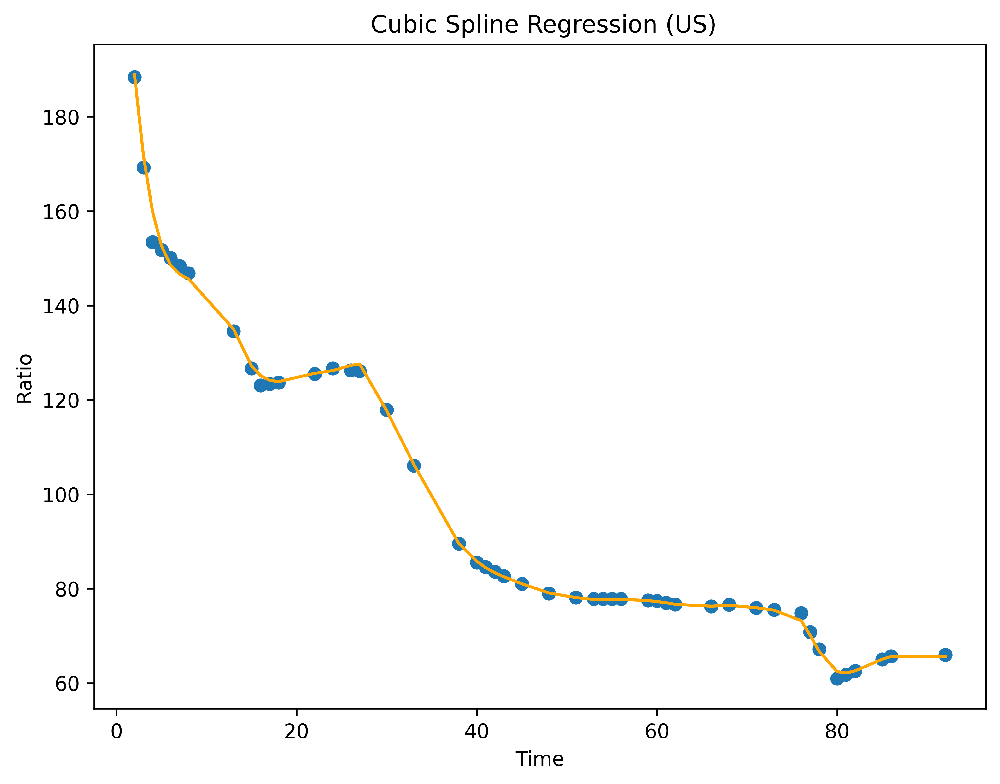

MSE= 1.516238823718512


In [21]:
cubic(X, y_US, 'US')

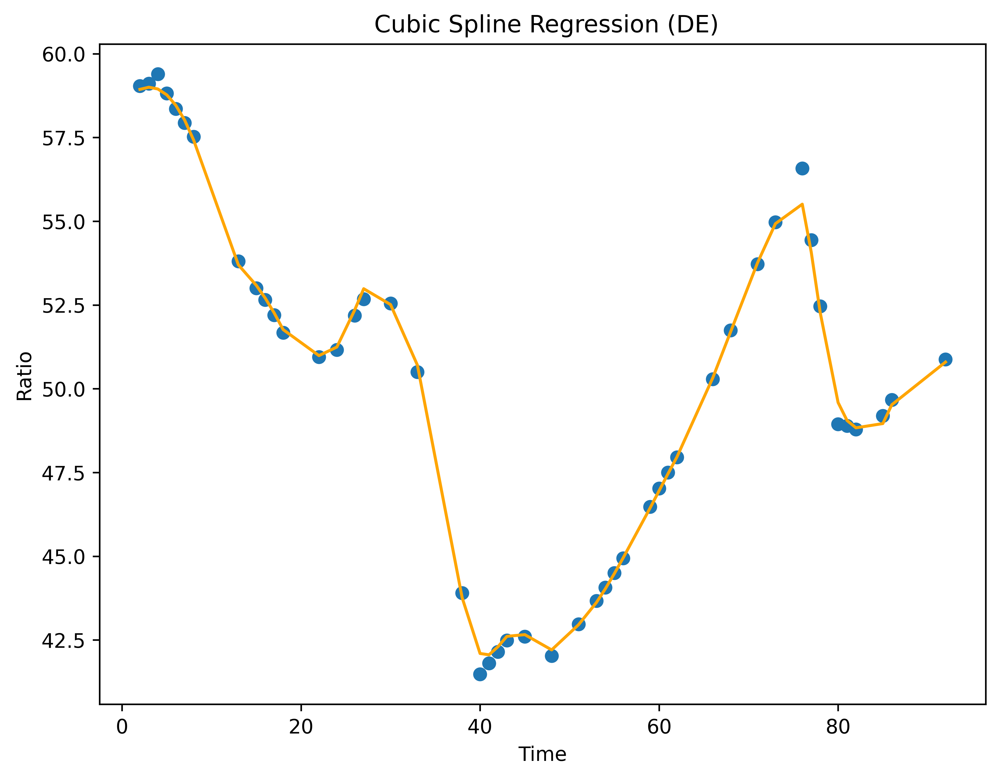

MSE= 0.06076856497367265


In [22]:
cubic(X, y_DE, 'DE')

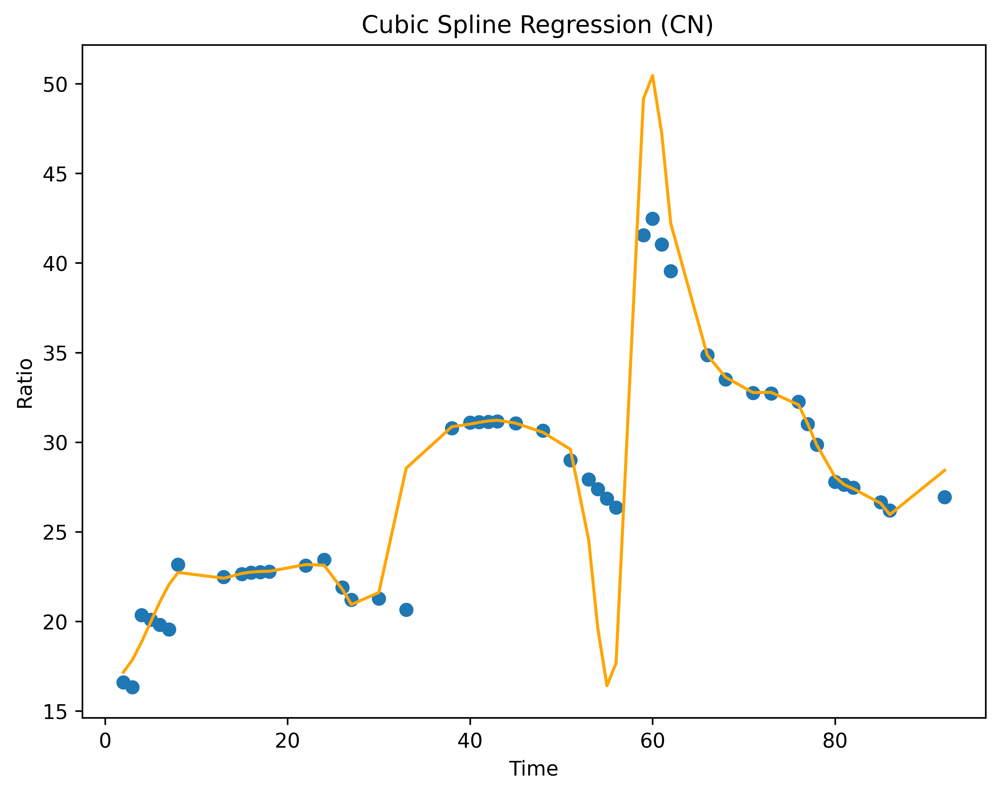

MSE= 10.687576922332594


In [23]:
cubic(X, y_CN, 'CN')

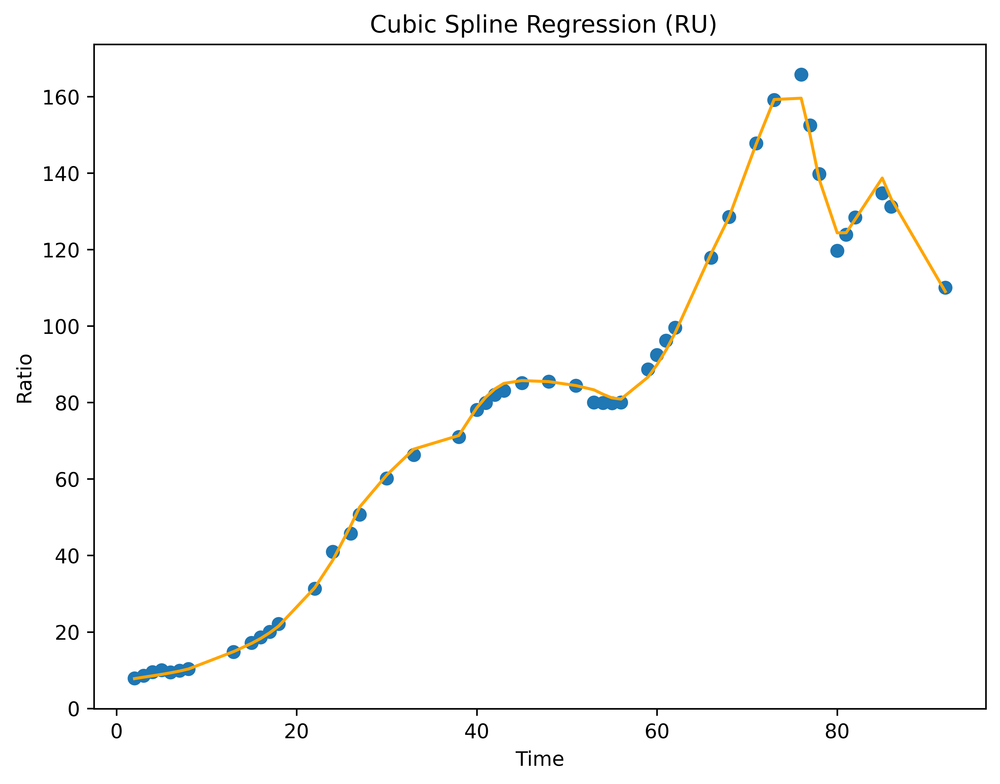

MSE= 3.34482048058144


In [24]:
cubic(X, y_RU, 'RU')